In [1]:
#I have installed all the necessary libraries required for the project
!pip install opencv-python
!pip install numpy
!pip install matplotlib
!pip install tensorflow
!pip install scikit-learn

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/cf/24/271e77c22724f370c24c705f394b8035b4d27e4c2c6339f3f45ab9b8258e/tensorflow-2.18.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow-2.18.0-cp311-cp311-win_amd64.whl.metadata (3.3 kB)
  Obtaining dependency information for tensorflow-intel==2.18.0 from https://files.pythonhosted.org/packages/76/ad/fa6c508a15ff79cb5409294c293388e0999b7d480f84b65e4287277434fe/tensorflow_intel-2.18.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow_intel-2.18.0-cp311-cp311-win_amd64.whl.metadata (4.9 kB)
  Obtaining dependency information for absl-py>=1.0.0 from https://files.pythonhosted.org/packages/a2/ad/e0d3c824784ff121c03cc031f944bc7e139a8f1870ffd2845cc2dd76f6c4/absl_py-2.1.0-py3-none-any.whl.metadata
  Using cached absl_py-2.1.0-py3-none-any.whl.metadata (2.3 kB)
  Obtaining dependency information for astunparse>=1.6.0 from https://files.pythonhosted.org/packages/2b/03/13dde6512ad7

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
gensim 4.3.0 requires FuzzyTM>=0.4.0, which is not installed.
tables 3.8.0 requires blosc2~=2.0.0, which is not installed.
tables 3.8.0 requires cython>=0.29.21, which is not installed.
numba 0.57.1 requires numpy<1.25,>=1.21, but you have numpy 1.26.4 which is incompatible.


In [3]:
#Import required libraries
import os
import numpy as np
import matplotlib.pyplot as plt
import cv2
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical

In [7]:
#Define the dataset path 
dataset_path = r'C:\Users\Atharva Vengurlekar\Downloads\Yoga_Pose_data'

# List the class folders of all the yogasanas
class_folders = [f for f in os.listdir(dataset_path) if os.path.isdir(os.path.join(dataset_path, f))]
print(f"Classes: {class_folders}")

Classes: ['Adho Mukha Svanasana', 'Adho Mukha Vrksasana', 'Alanasana', 'Anjaneyasana', 'Ardha Chandrasana', 'Ardha Matsyendrasana', 'Ardha Navasana', 'Ardha Pincha Mayurasana', 'Ashta Chandrasana', 'Baddha Konasana', 'Bakasana', 'Balasana', 'Bitilasana', 'Camatkarasana', 'Dhanurasana', 'Eka Pada Rajakapotasana', 'Garudasana', 'Halasana', 'Hanumanasana', 'Malasana', 'Marjaryasana', 'Navasana', 'Padmasana', 'Parsva Virabhadrasana', 'Parsvottanasana', 'Paschimottanasana', 'Phalakasana', 'Pincha Mayurasana', 'Salamba Bhujangasana', 'Salamba Sarvangasana', 'Setu Bandha Sarvangasana', 'Sivasana', 'Supta Kapotasana', 'Trikonasana', 'Upavistha Konasana', 'Urdhva Dhanurasana', 'Urdhva Mukha Svsnssana', 'Ustrasana', 'Utkatasana', 'Uttanasana', 'Utthita Hasta Padangusthasana', 'Utthita Parsvakonasana', 'Vasisthasana', 'Virabhadrasana One', 'Virabhadrasana Three', 'Virabhadrasana Two', 'Vrksasana']


Displaying images for class: Adho Mukha Svanasana


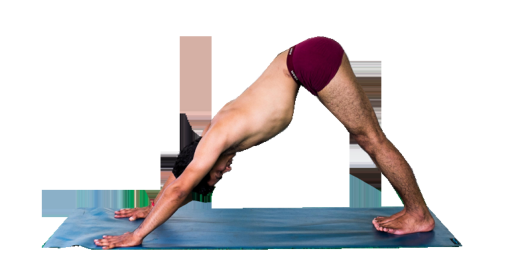

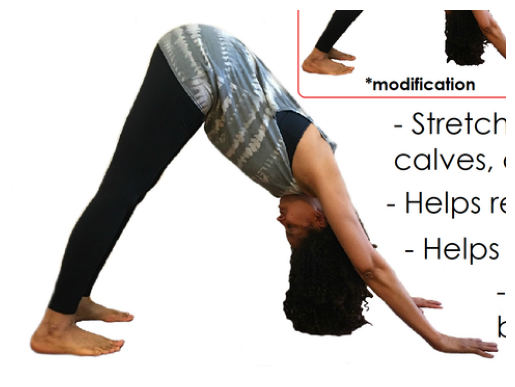

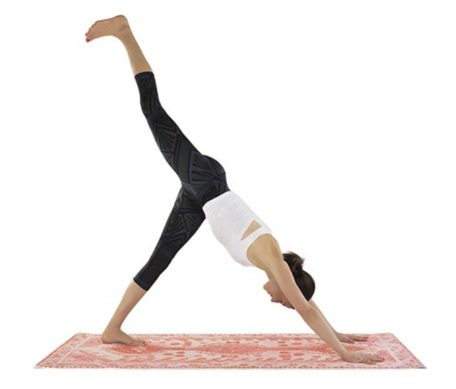

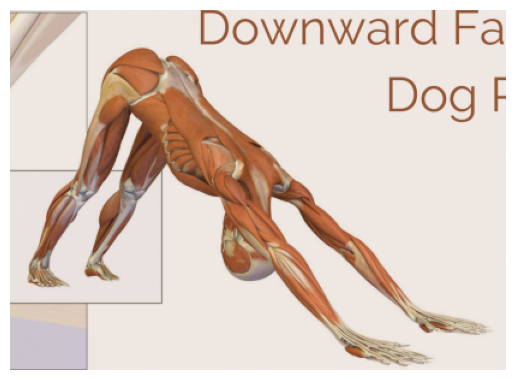

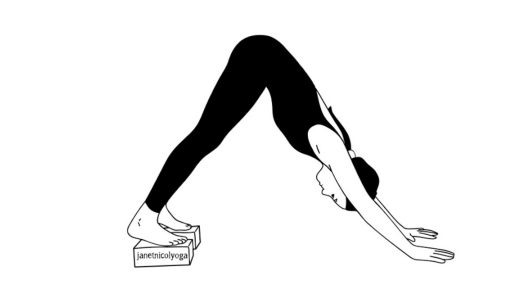

Displaying images for class: Adho Mukha Vrksasana


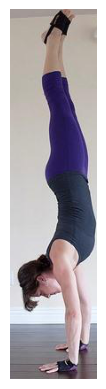

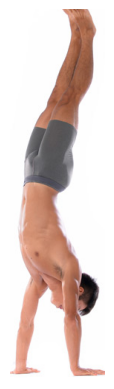

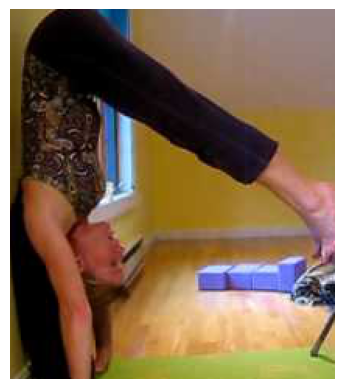

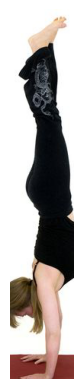

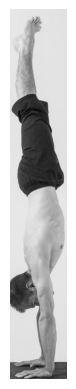

Displaying images for class: Alanasana


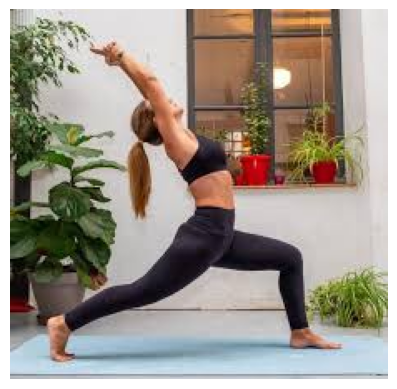

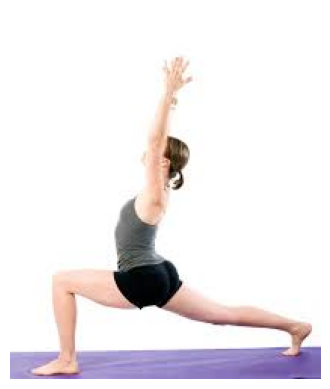

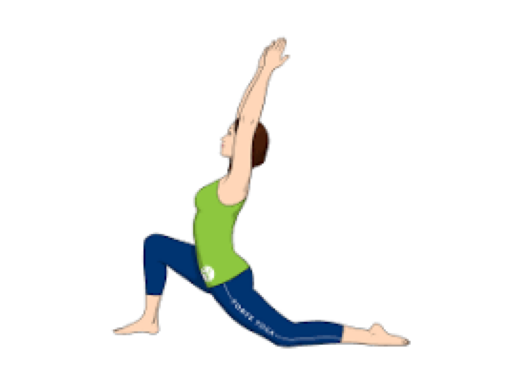

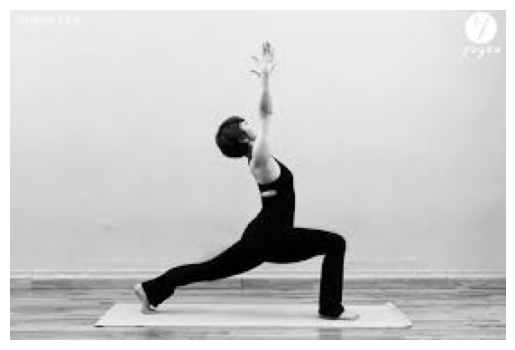

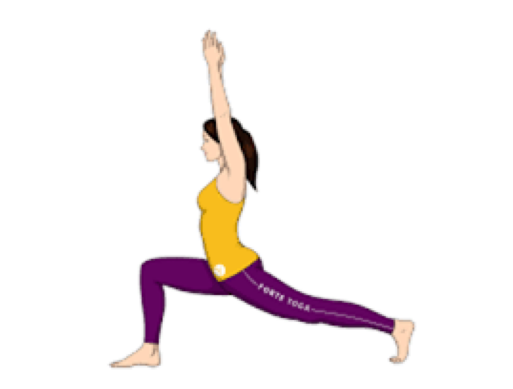

Displaying images for class: Anjaneyasana


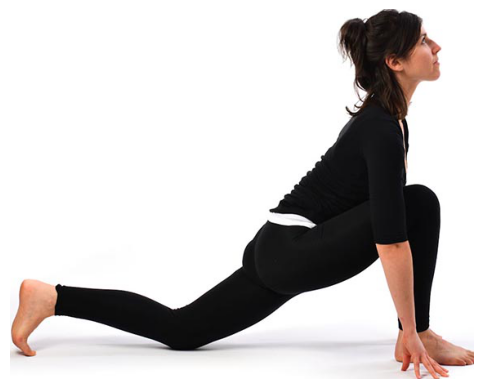

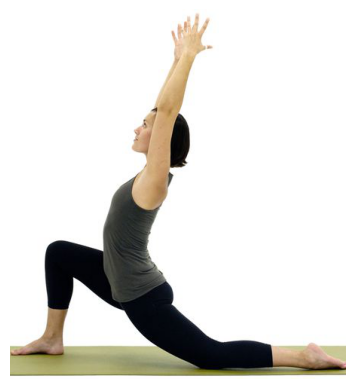

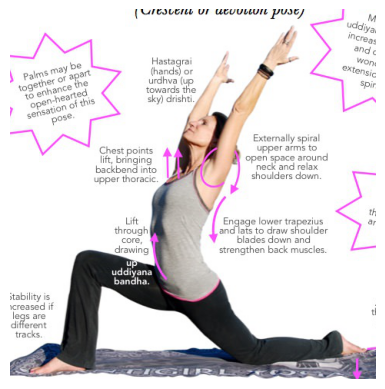

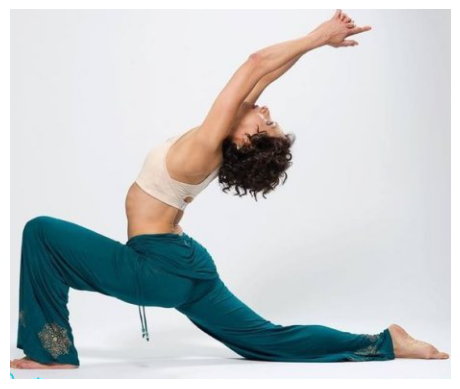

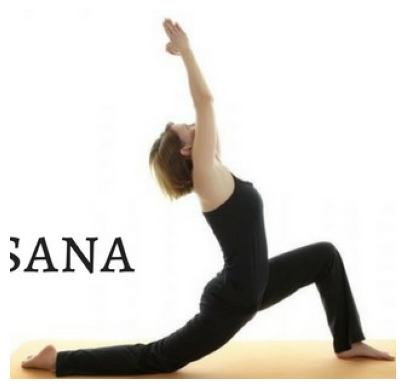

Displaying images for class: Ardha Chandrasana


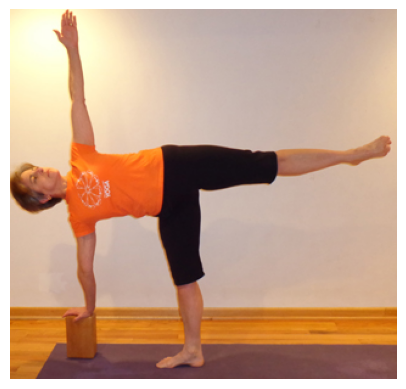

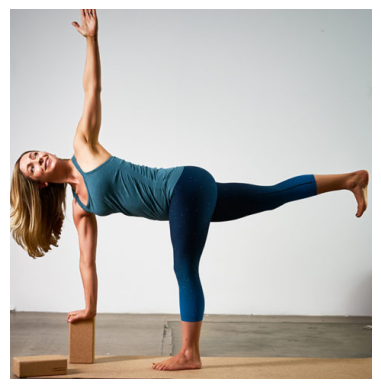

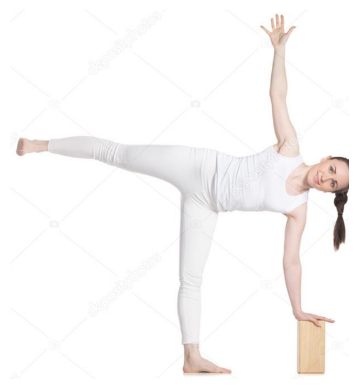

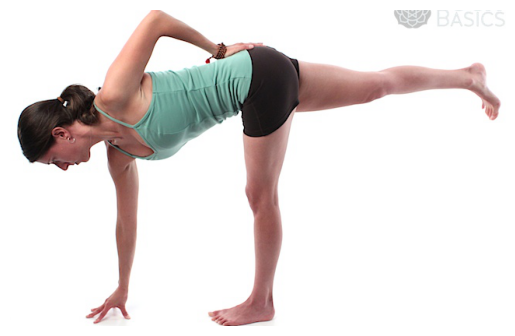

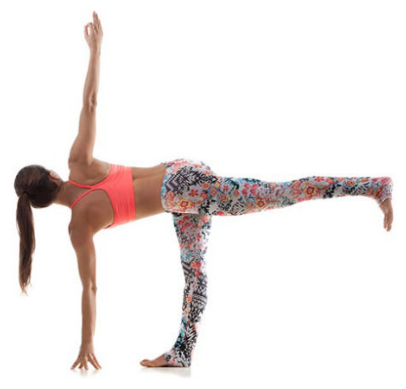

Displaying images for class: Ardha Matsyendrasana


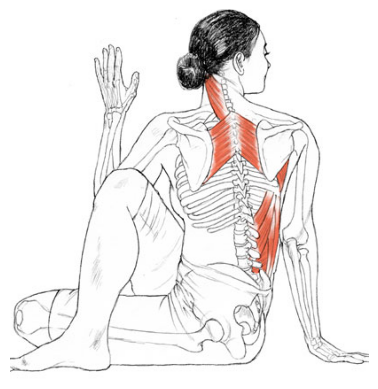

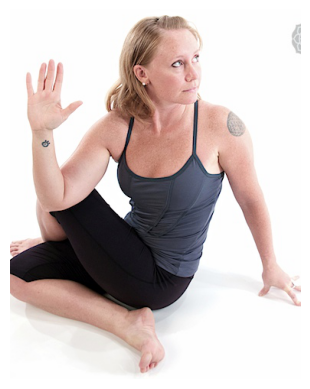

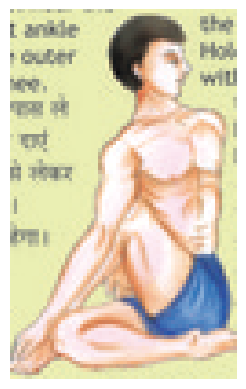

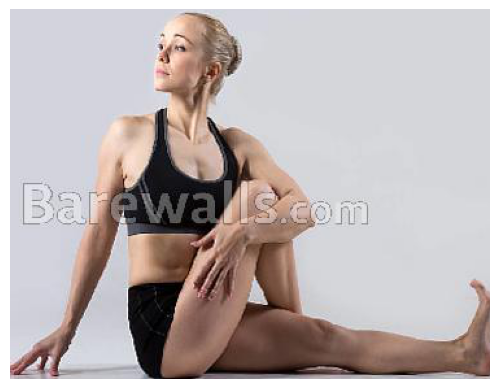

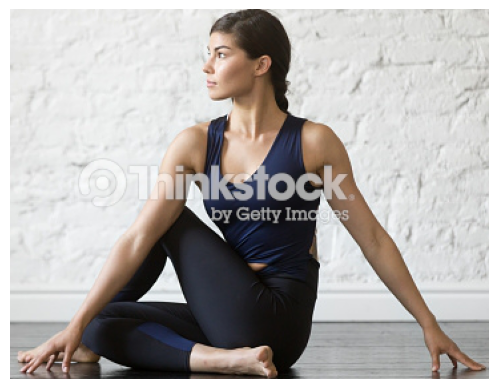

Displaying images for class: Ardha Navasana


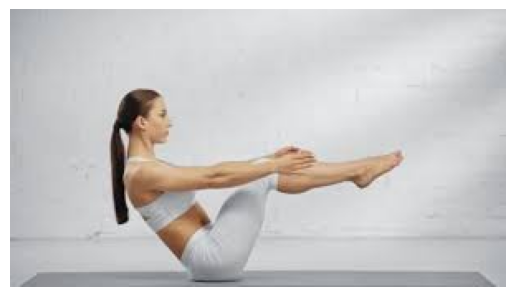

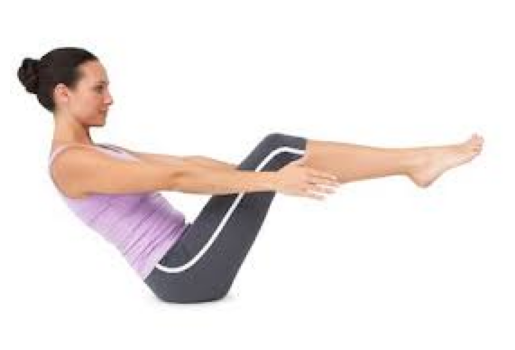

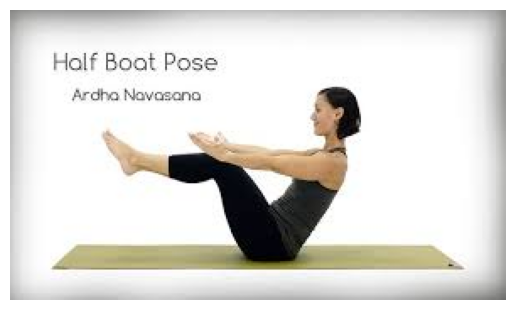

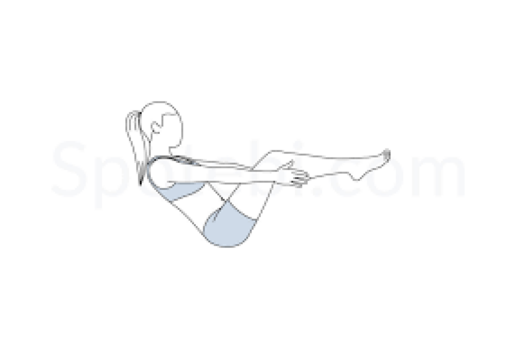

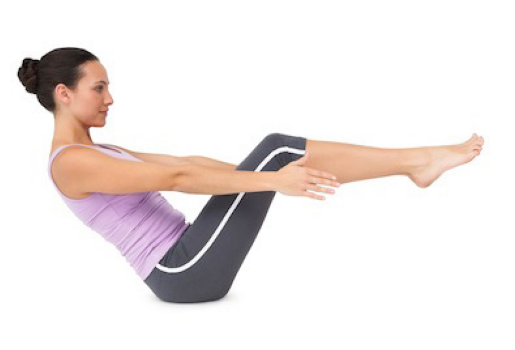

Displaying images for class: Ardha Pincha Mayurasana


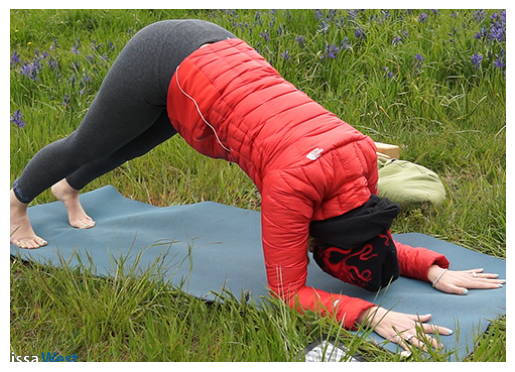

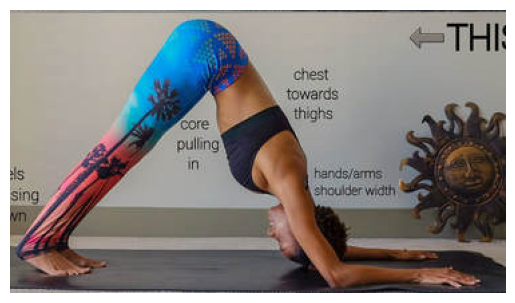

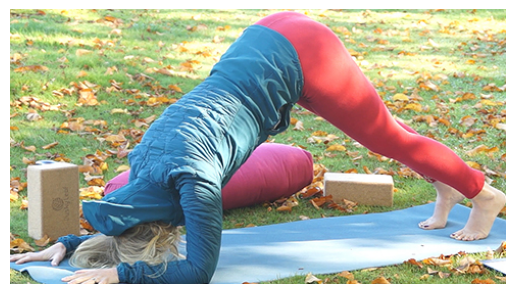

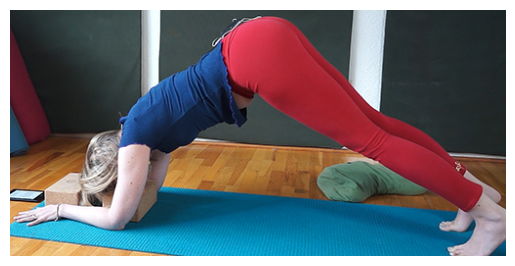

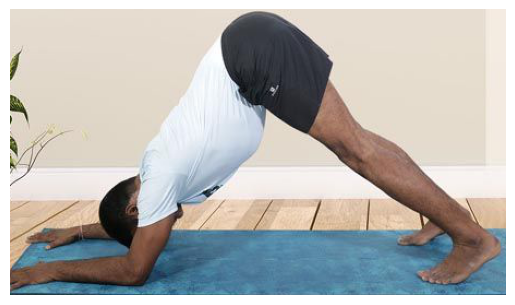

Displaying images for class: Ashta Chandrasana


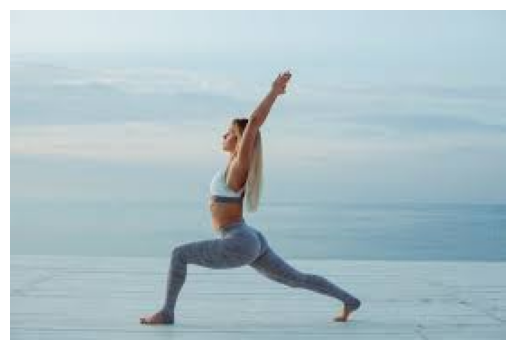

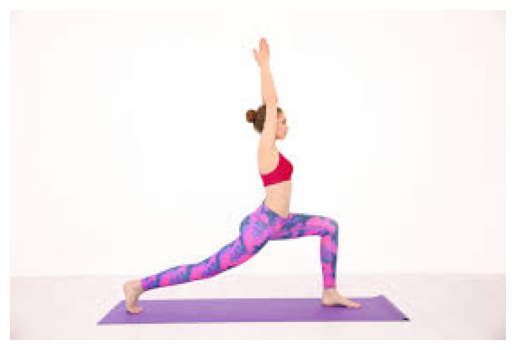

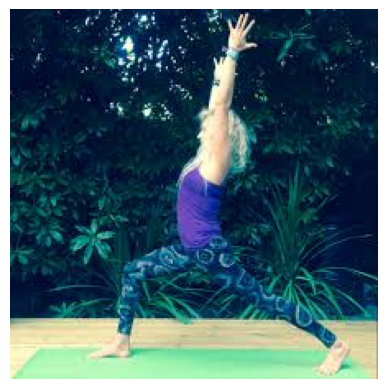

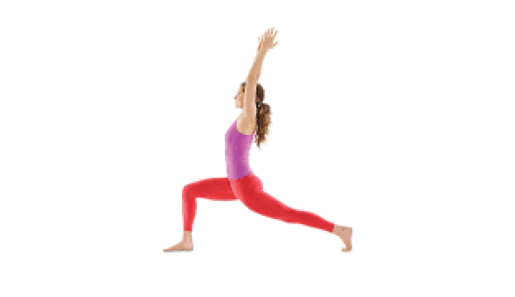

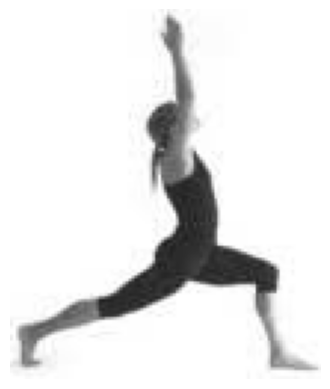

Displaying images for class: Baddha Konasana


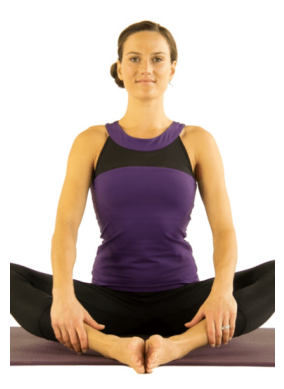

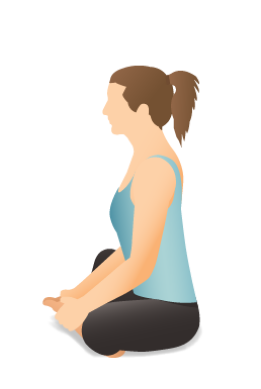

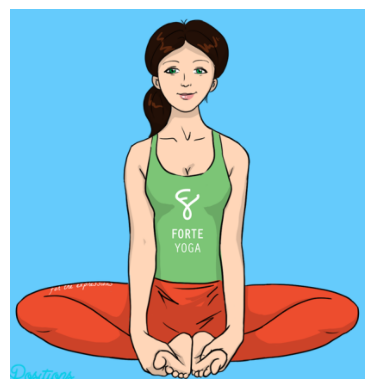

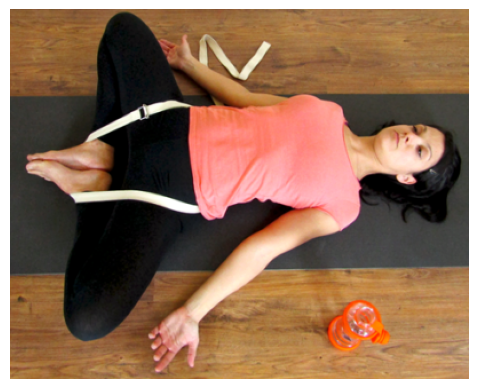

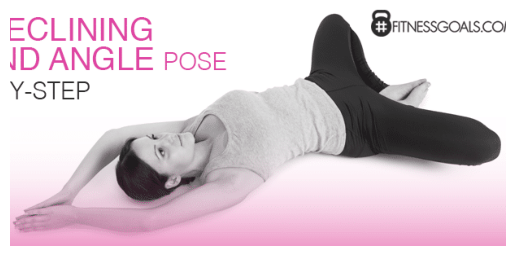

Displaying images for class: Bakasana


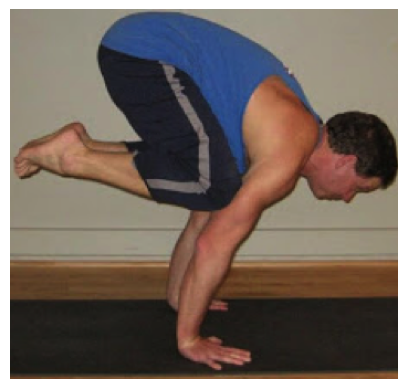

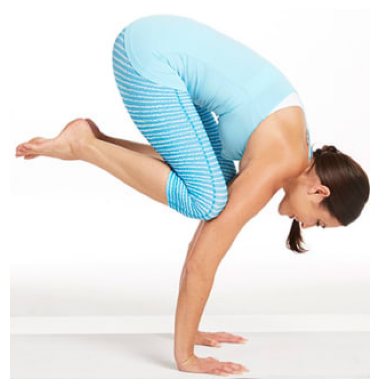

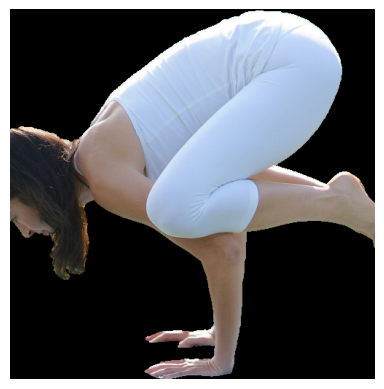

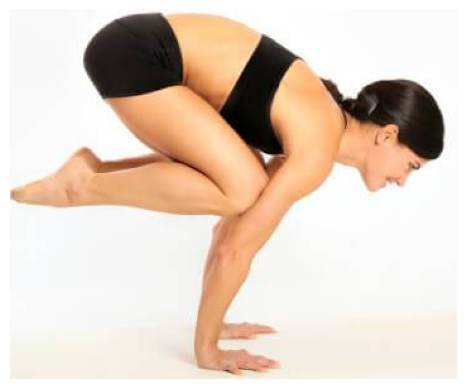

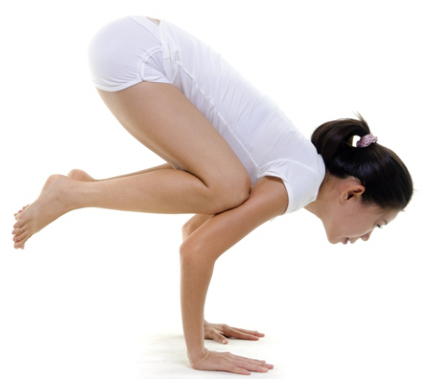

Displaying images for class: Balasana


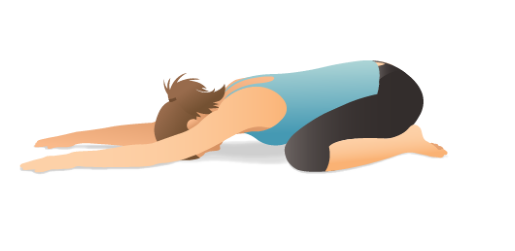

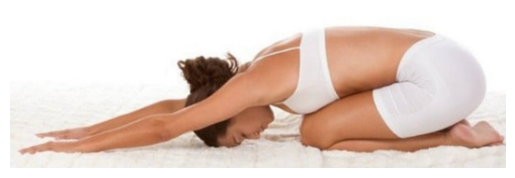

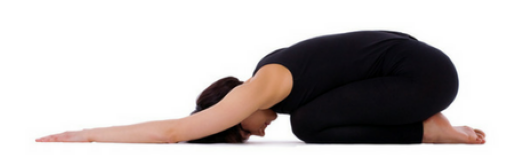

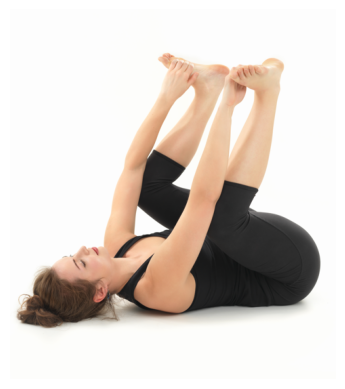

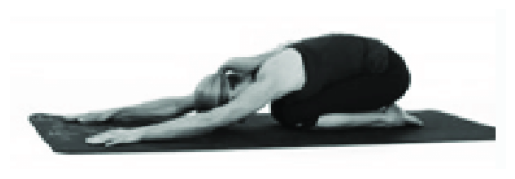

Displaying images for class: Bitilasana


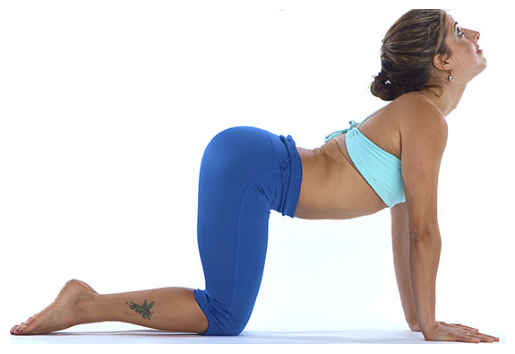

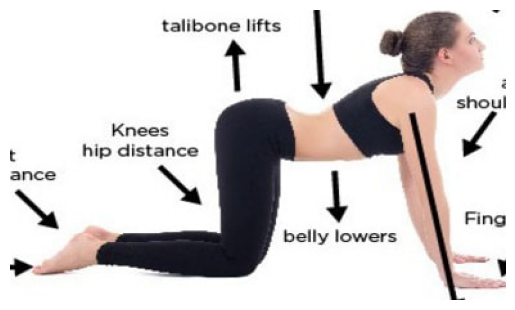

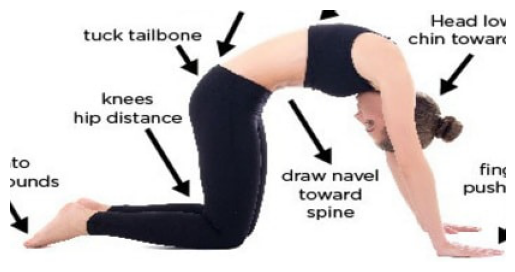

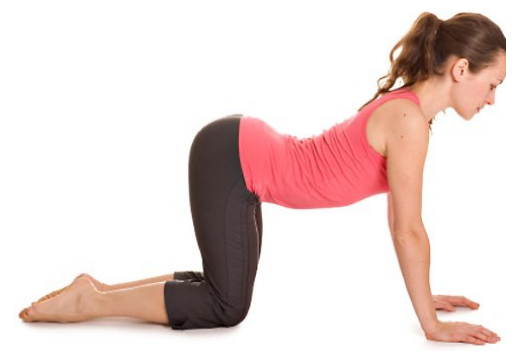

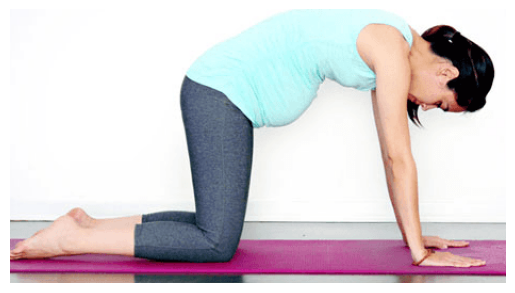

Displaying images for class: Camatkarasana


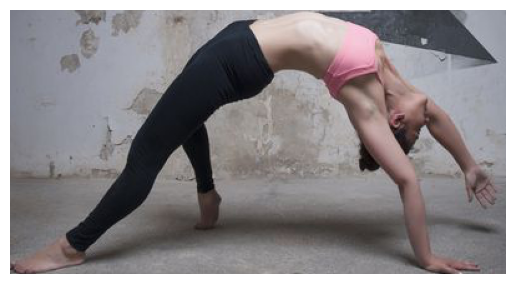

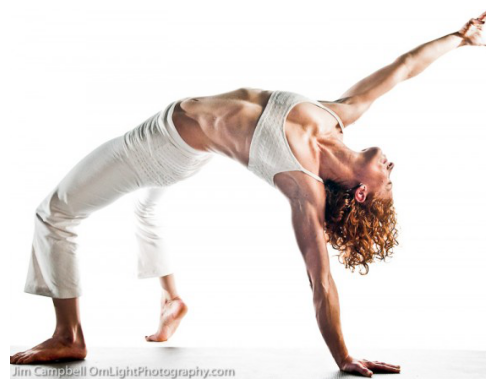

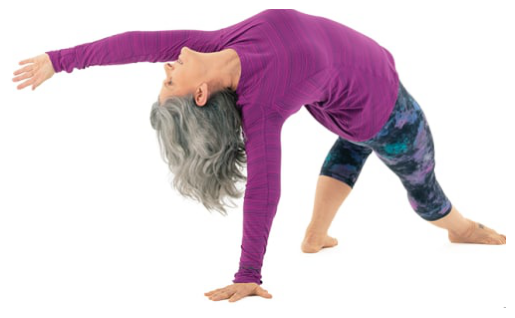

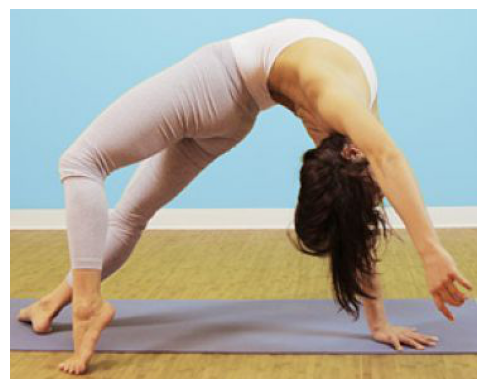

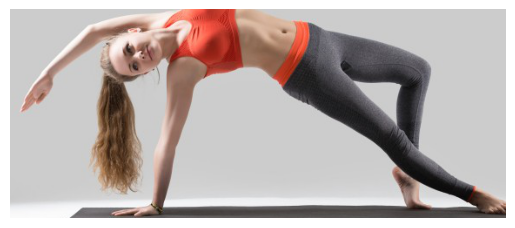

Displaying images for class: Dhanurasana


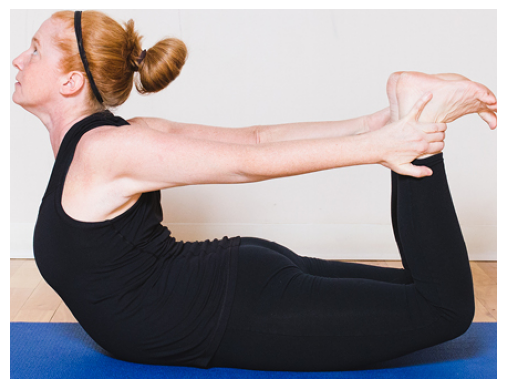

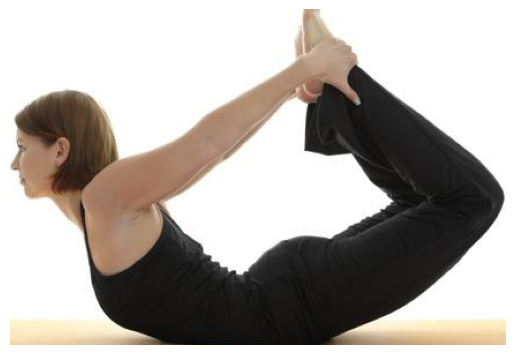

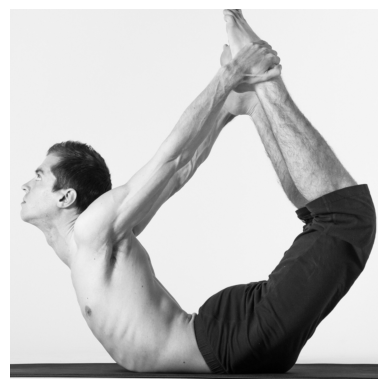

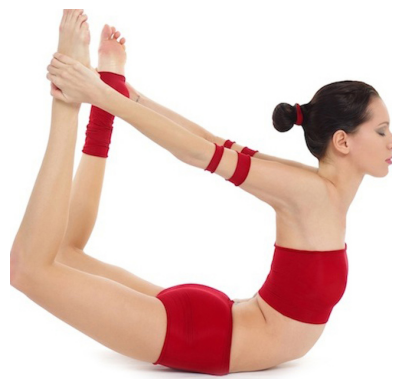

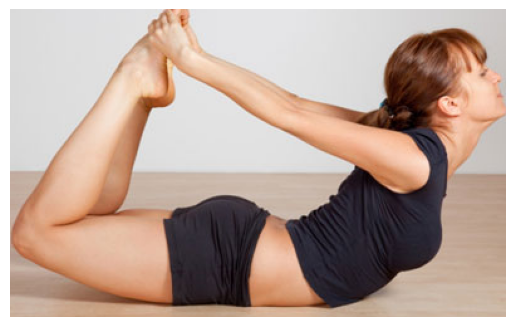

Displaying images for class: Eka Pada Rajakapotasana


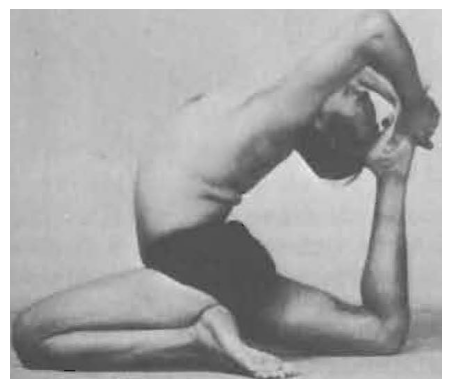

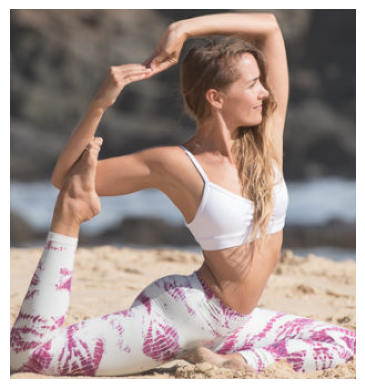

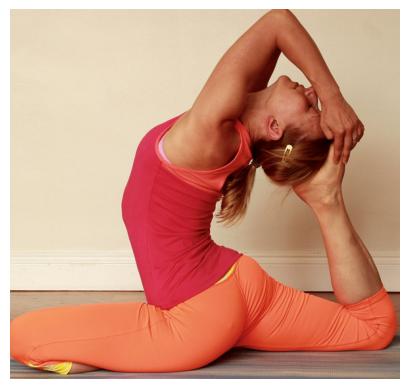

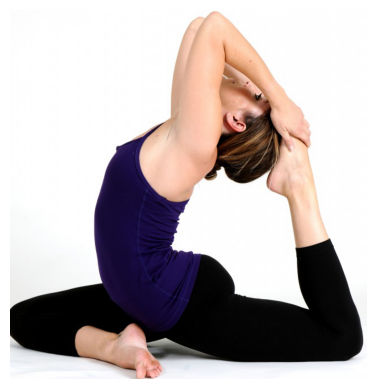

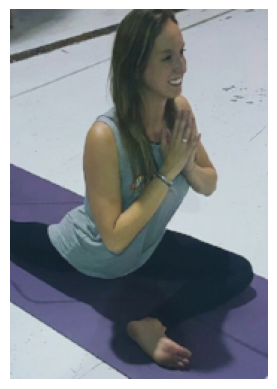

Displaying images for class: Garudasana


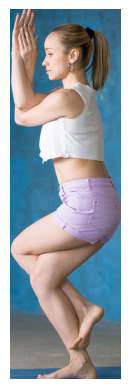

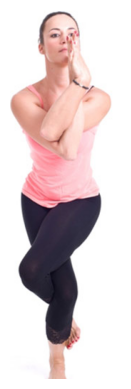

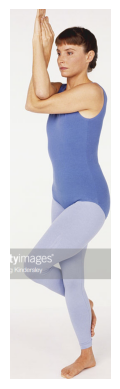

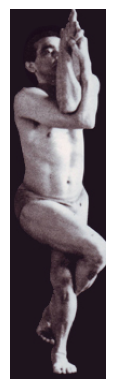

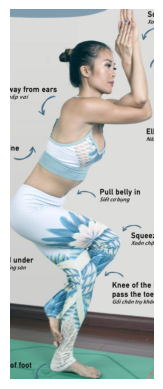

Displaying images for class: Halasana


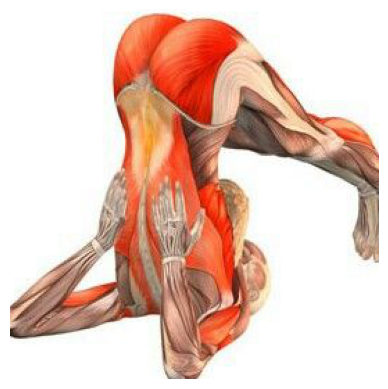

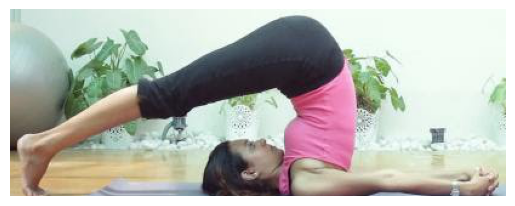

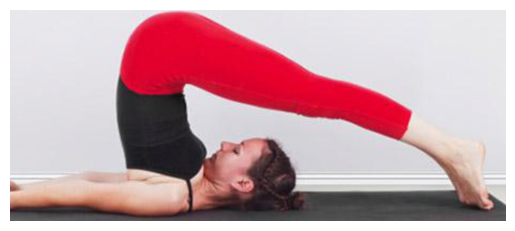

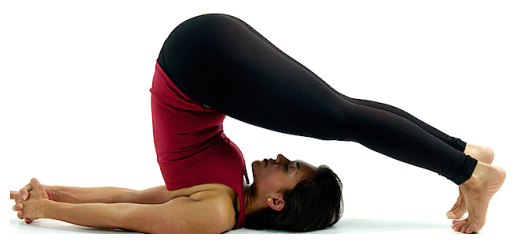

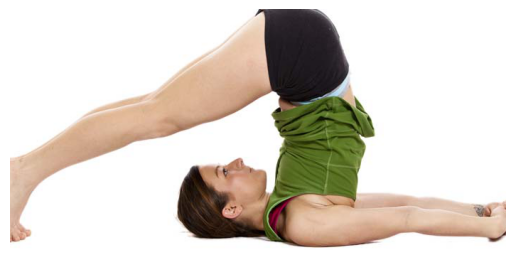

Displaying images for class: Hanumanasana


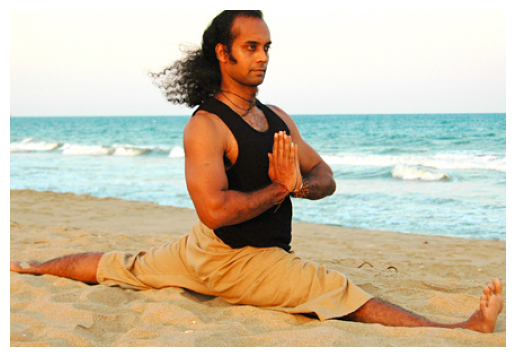

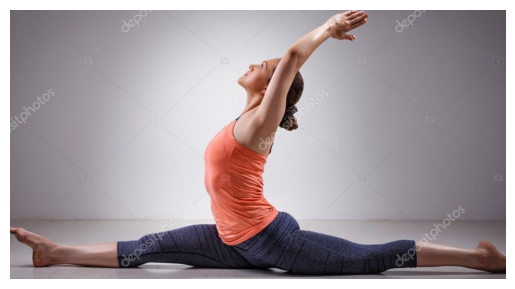

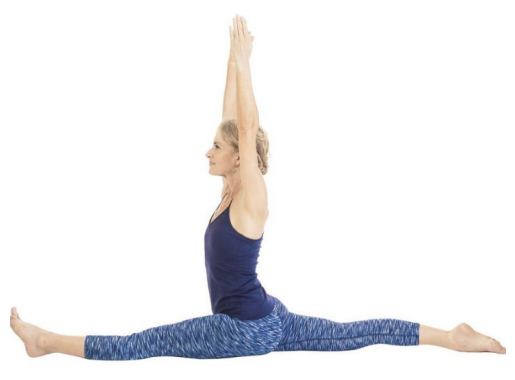

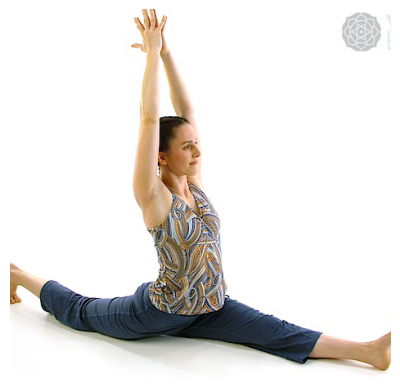

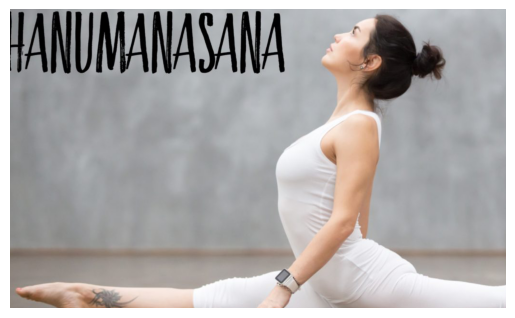

Displaying images for class: Malasana


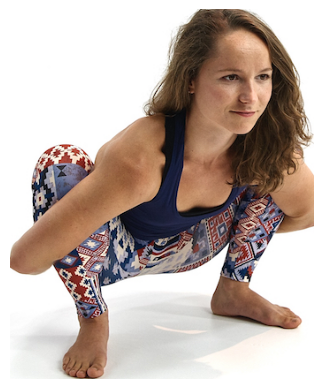

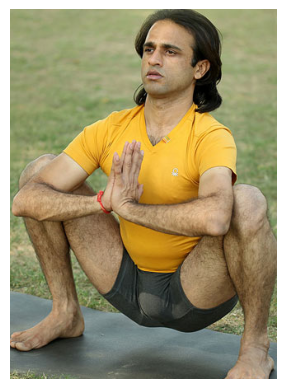

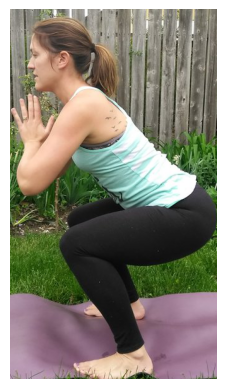

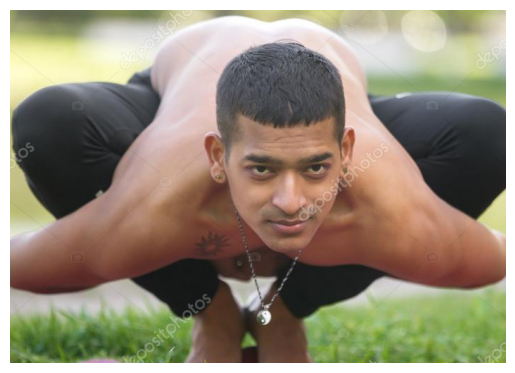

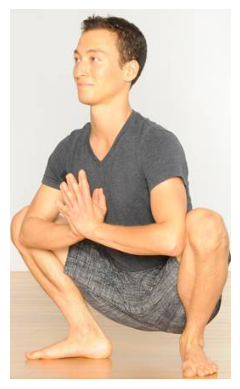

Displaying images for class: Marjaryasana


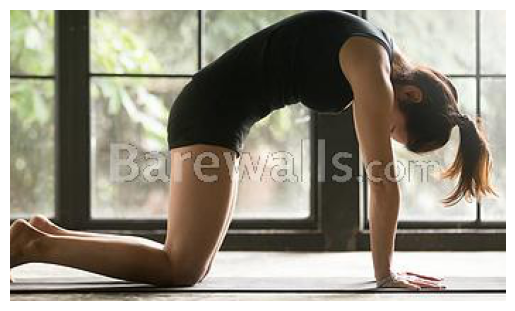

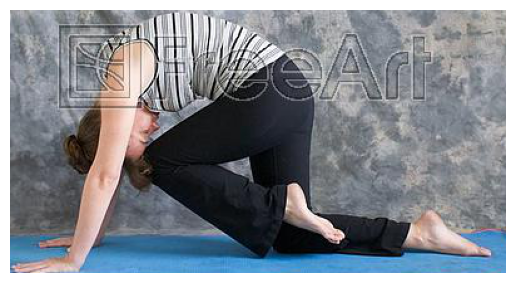

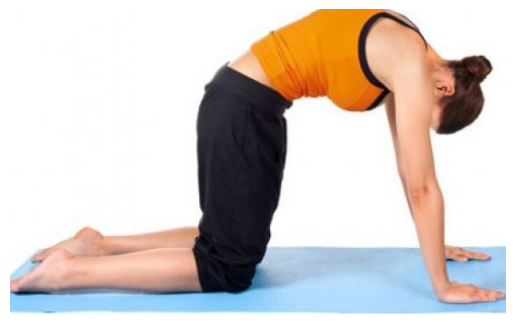

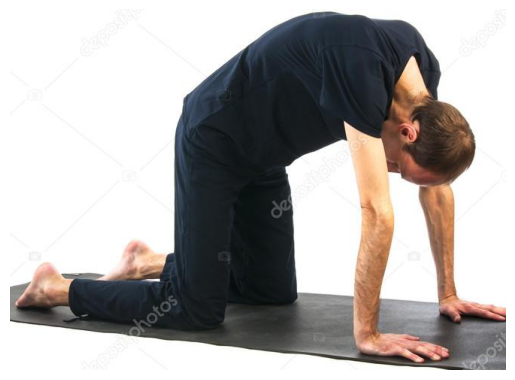

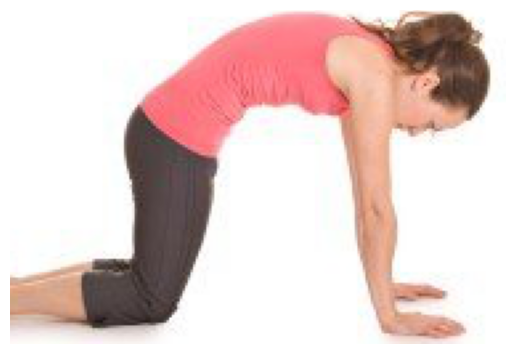

Displaying images for class: Navasana


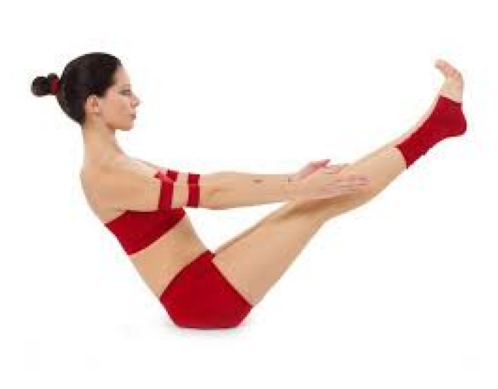

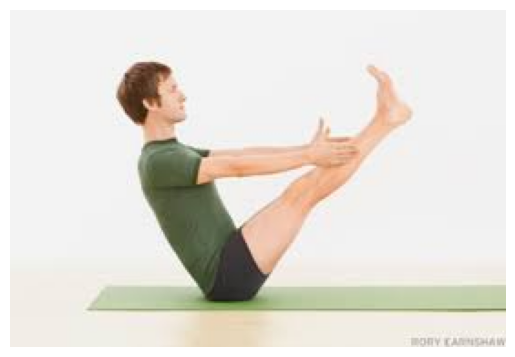

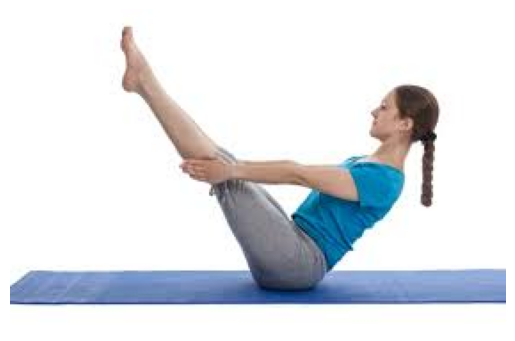

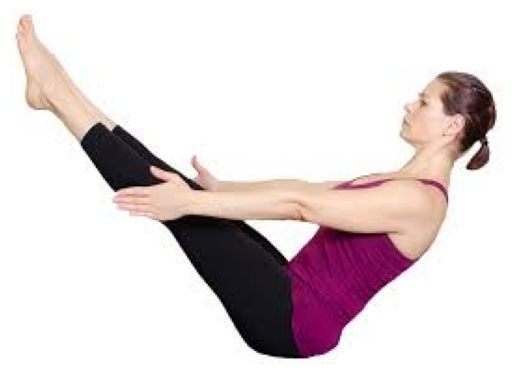

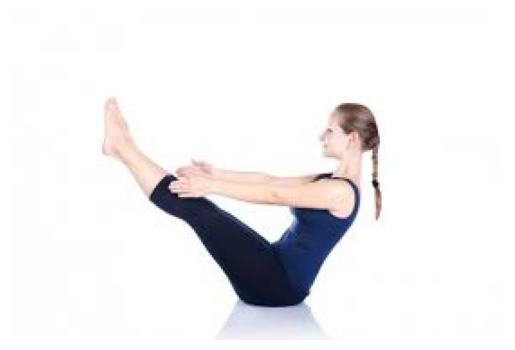

Displaying images for class: Padmasana


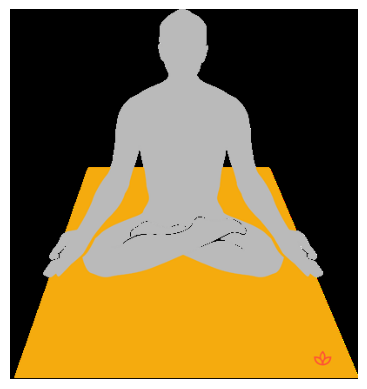

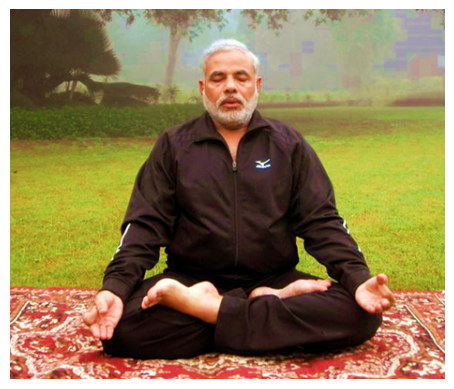

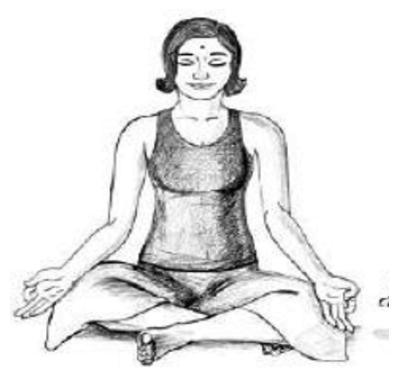

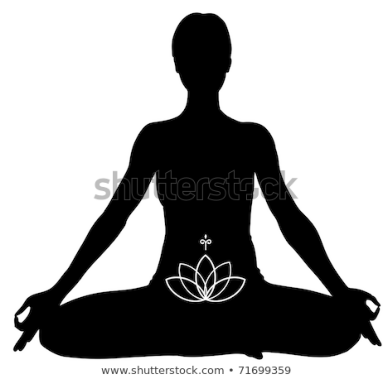

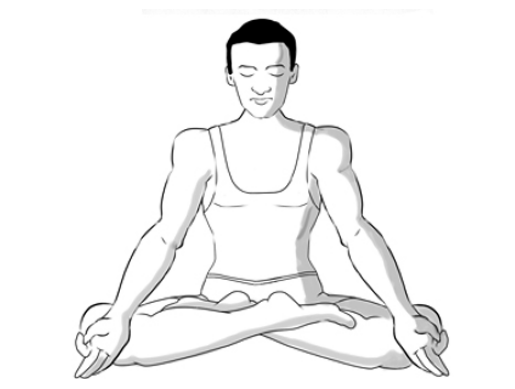

Displaying images for class: Parsva Virabhadrasana


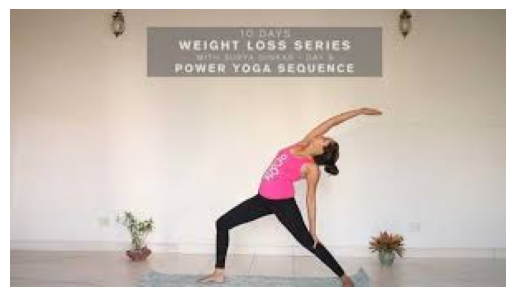

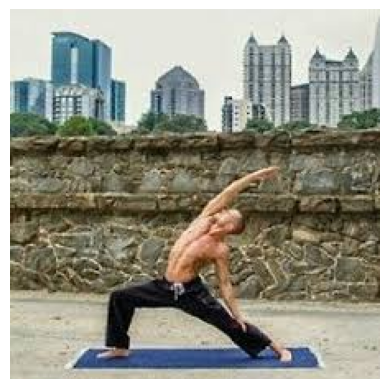

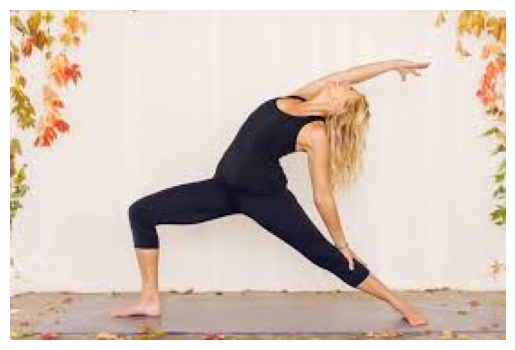

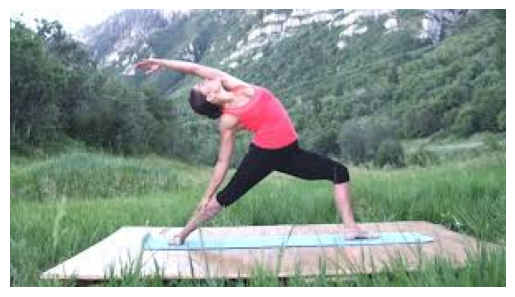

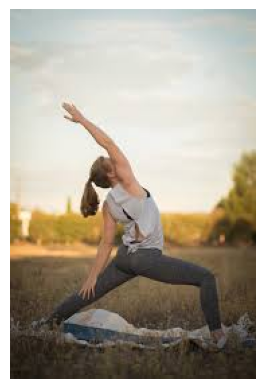

Displaying images for class: Parsvottanasana


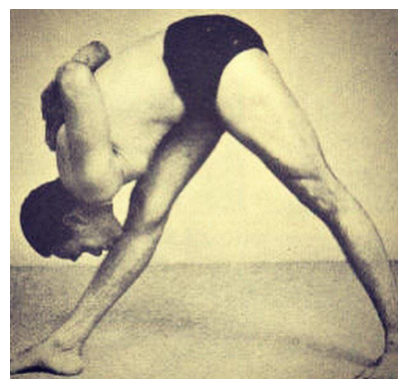

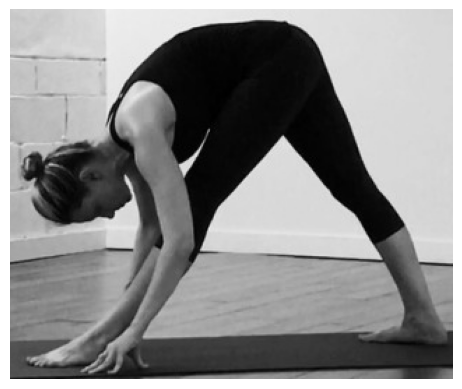

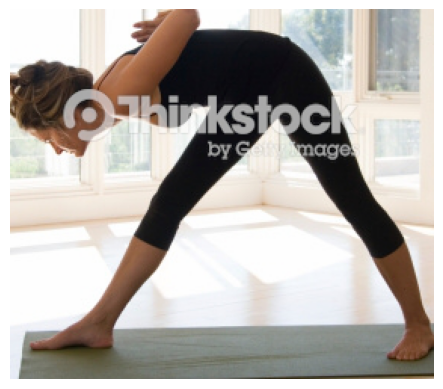

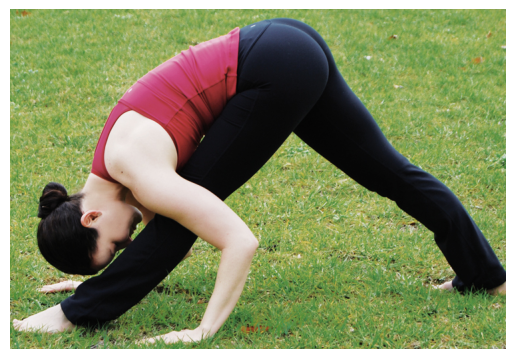

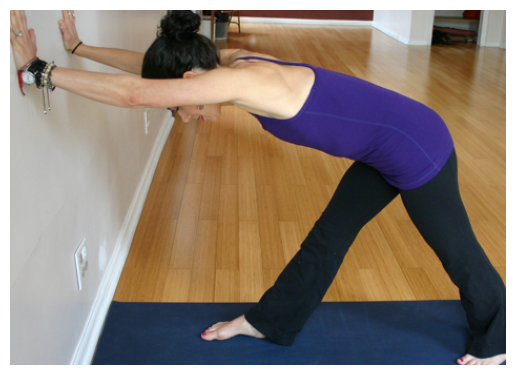

Displaying images for class: Paschimottanasana


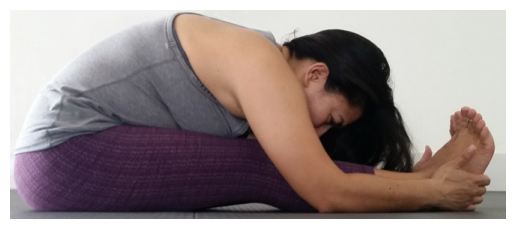

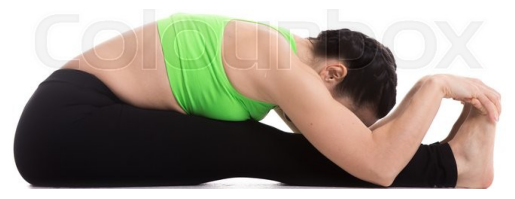

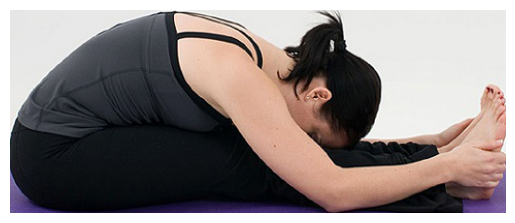

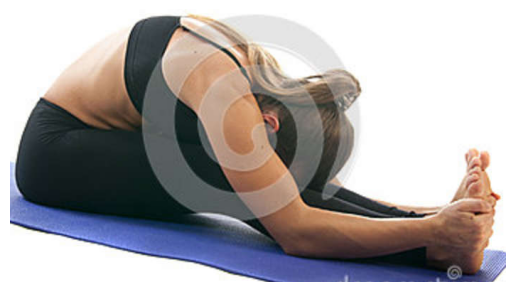

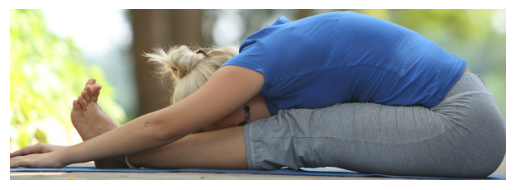

Displaying images for class: Phalakasana


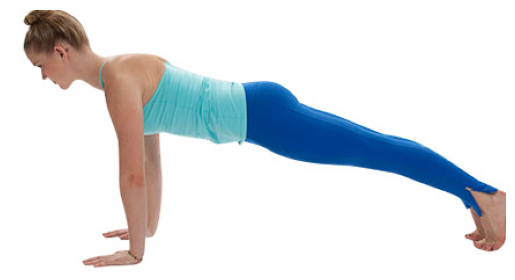

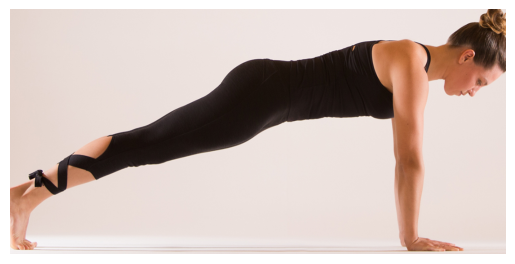

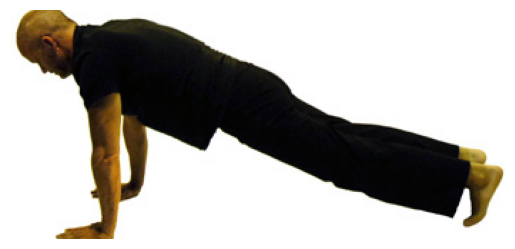

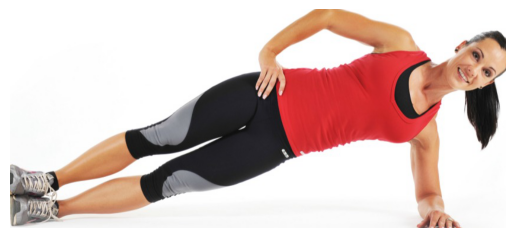

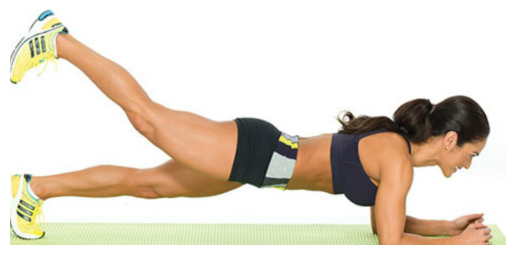

Displaying images for class: Pincha Mayurasana


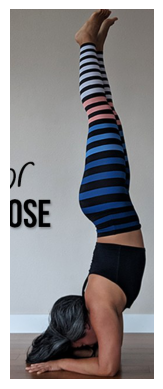

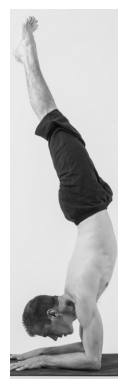

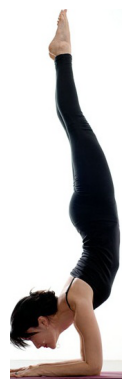

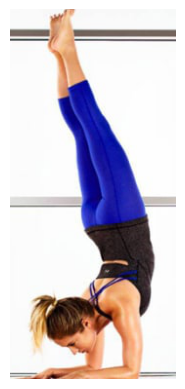

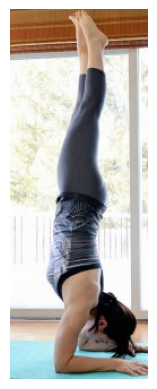

Displaying images for class: Salamba Bhujangasana


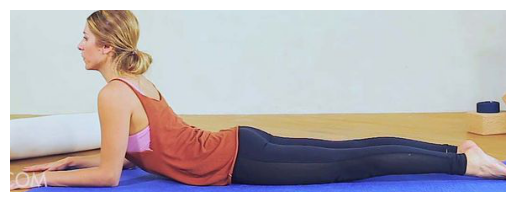

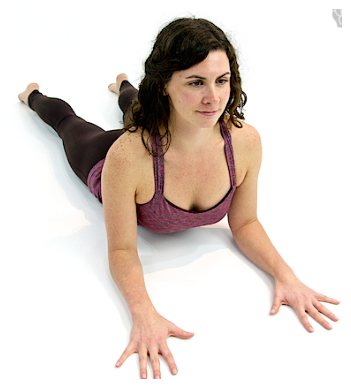

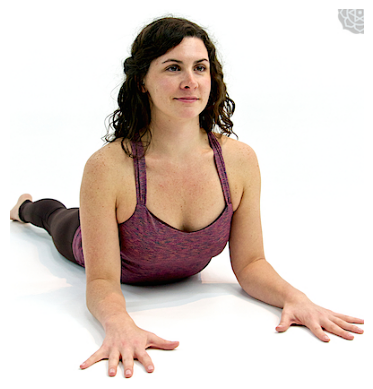

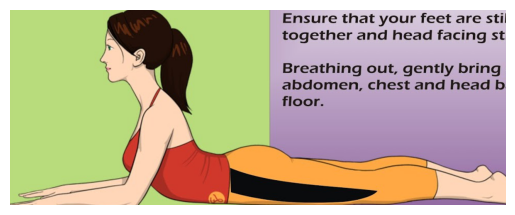

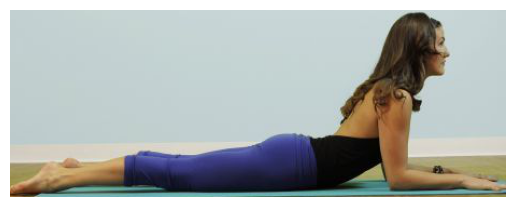

Displaying images for class: Salamba Sarvangasana


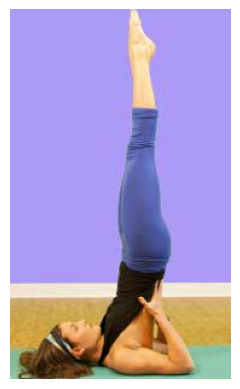

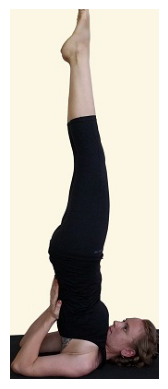

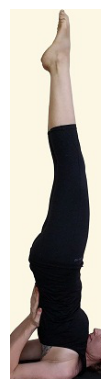

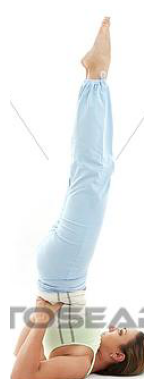

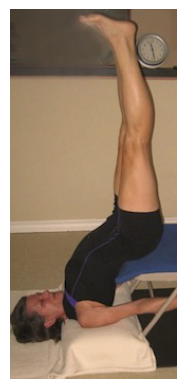

Displaying images for class: Setu Bandha Sarvangasana


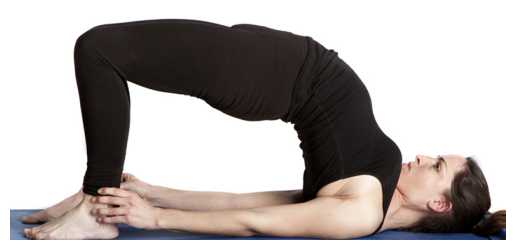

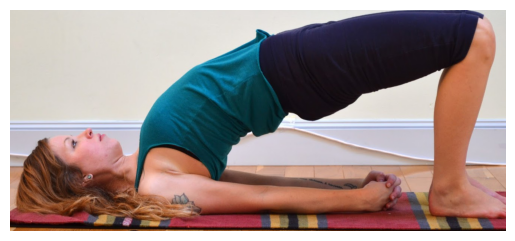

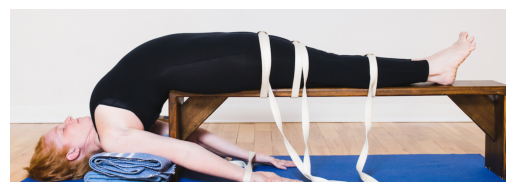

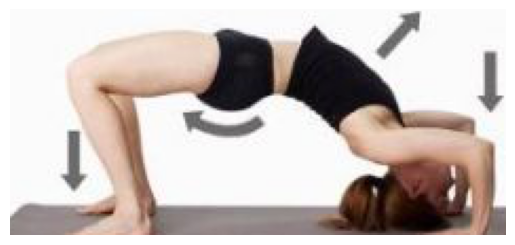

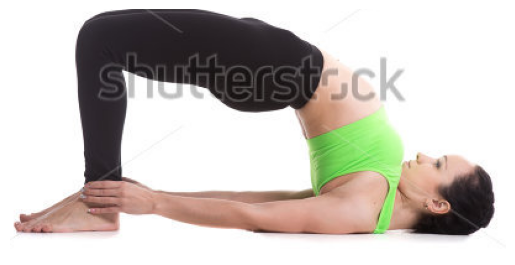

Displaying images for class: Sivasana


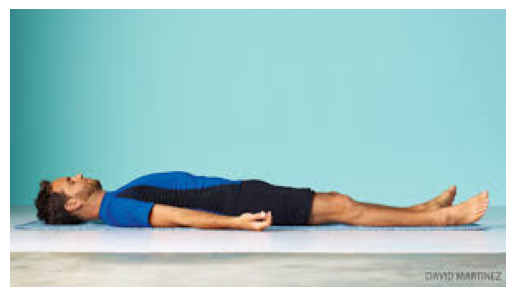

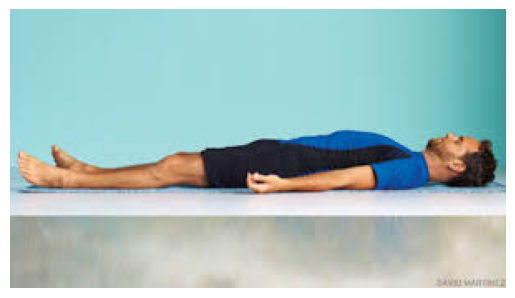

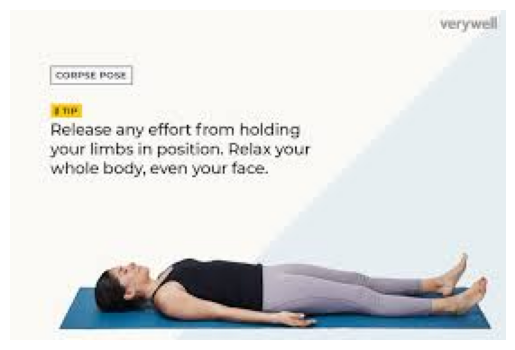

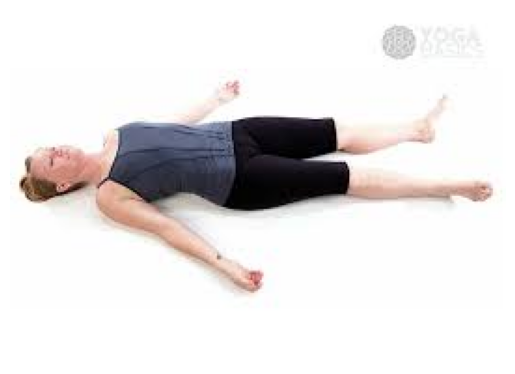

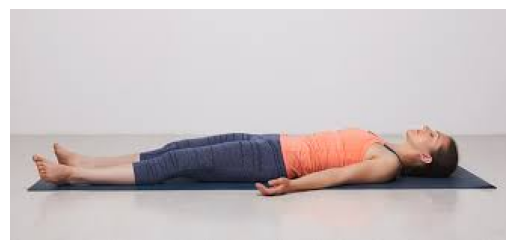

Displaying images for class: Supta Kapotasana


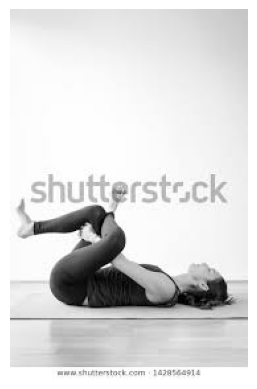

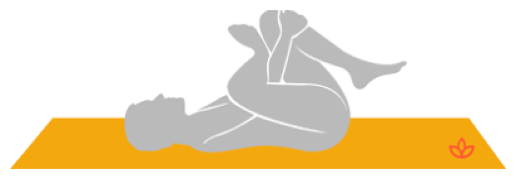

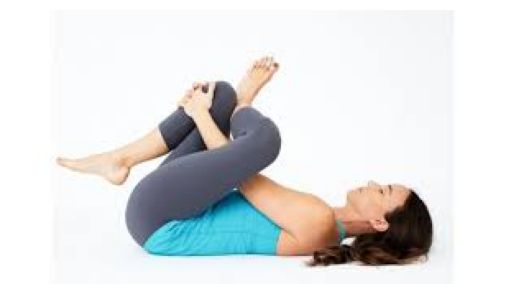

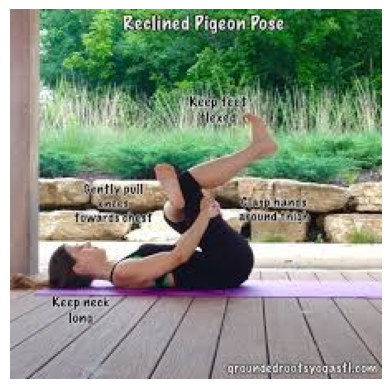

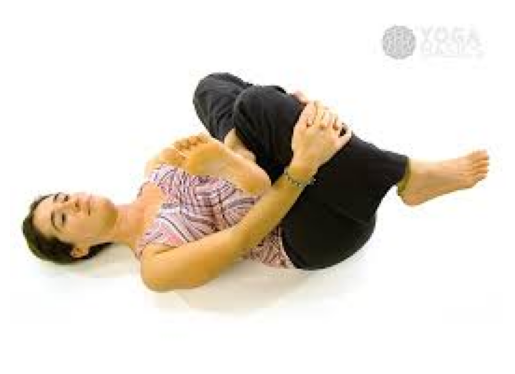

Displaying images for class: Trikonasana


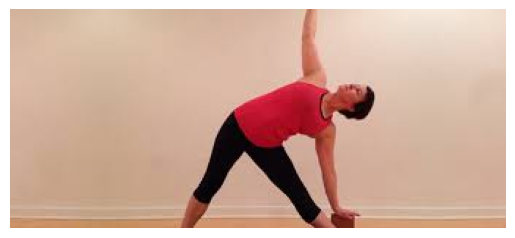

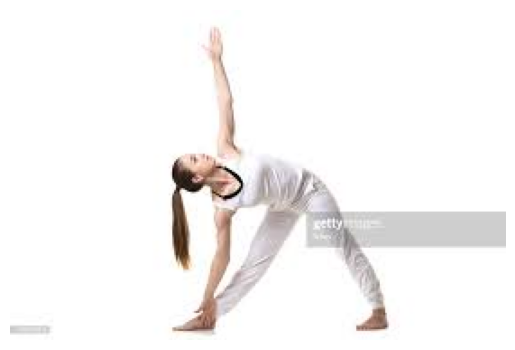

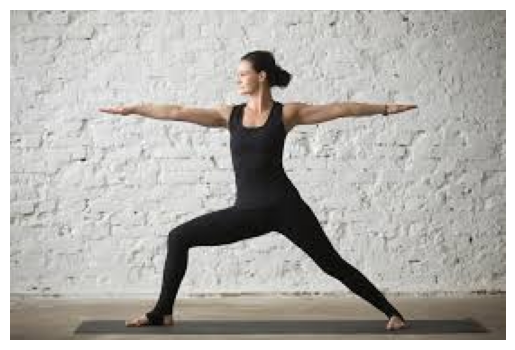

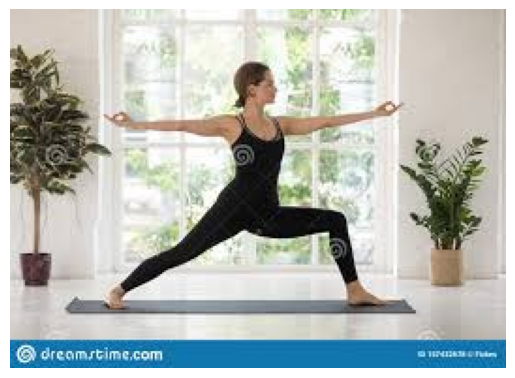

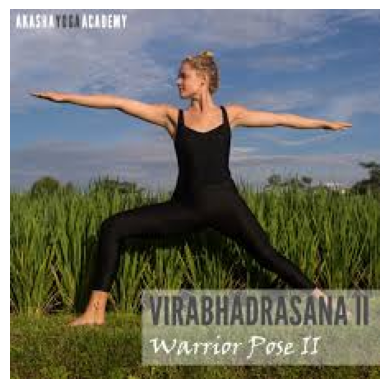

Displaying images for class: Upavistha Konasana


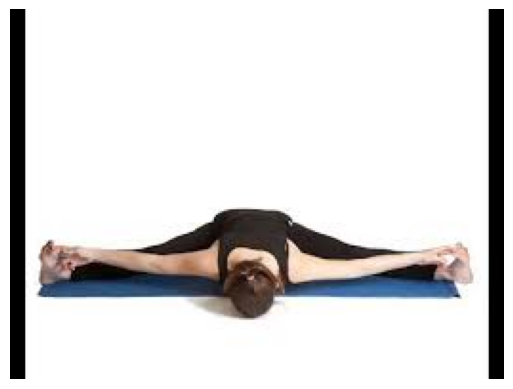

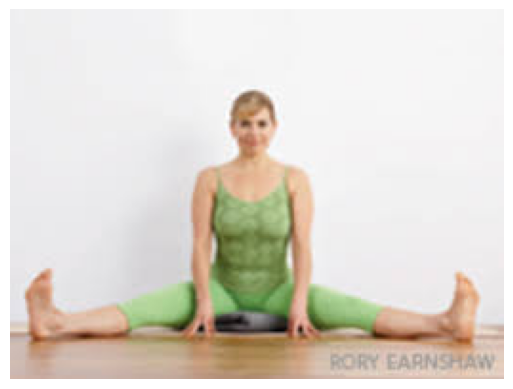

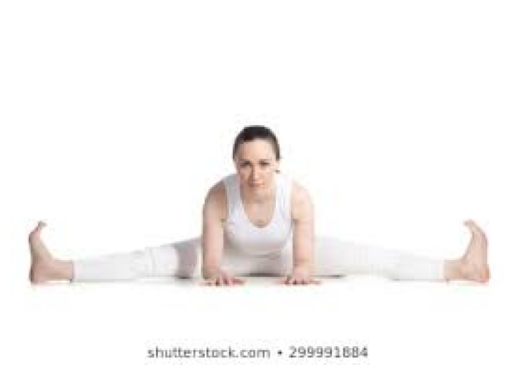

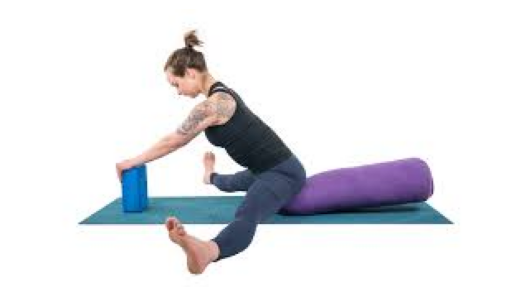

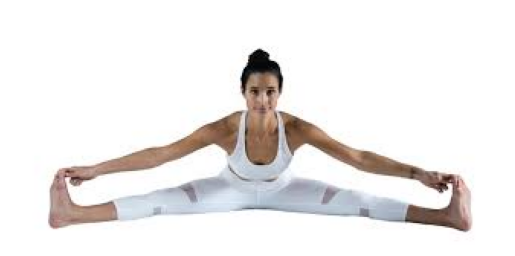

Displaying images for class: Urdhva Dhanurasana


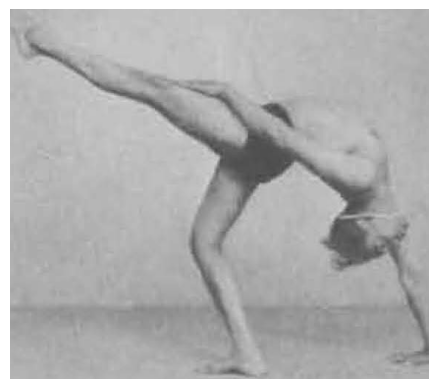

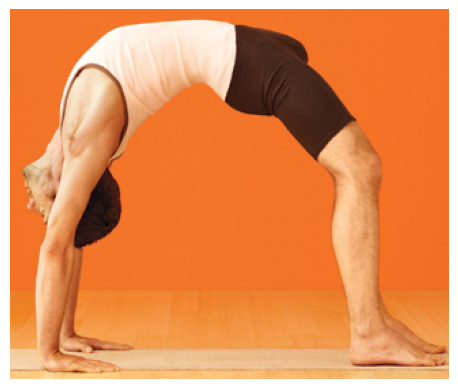

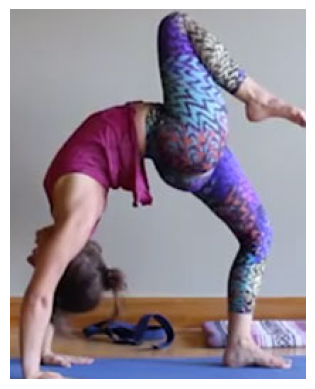

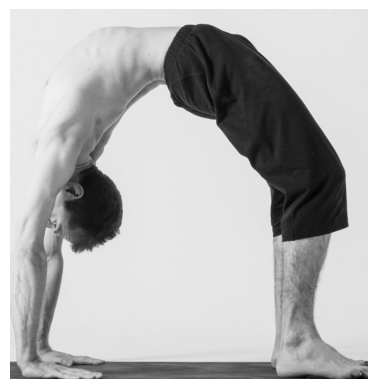

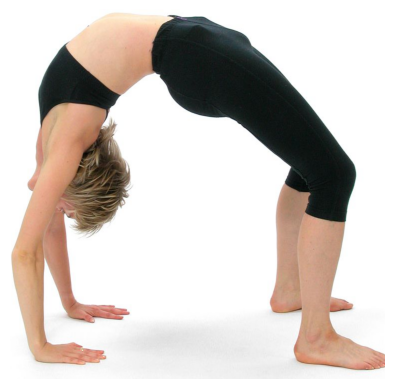

Displaying images for class: Urdhva Mukha Svsnssana


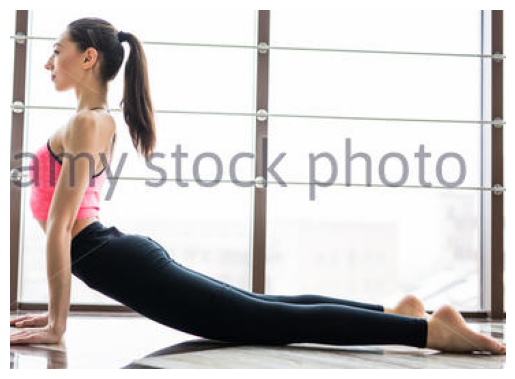

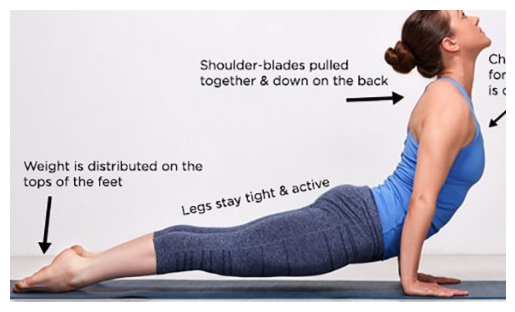

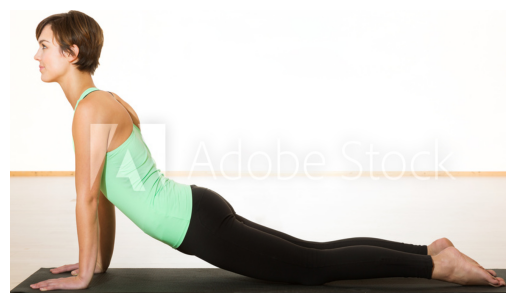

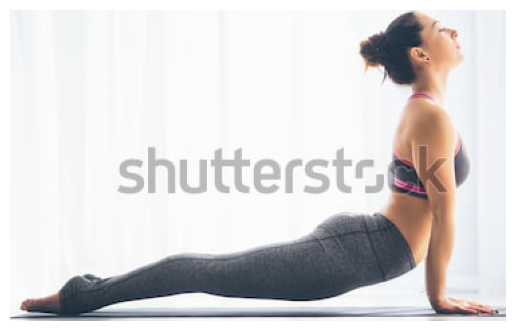

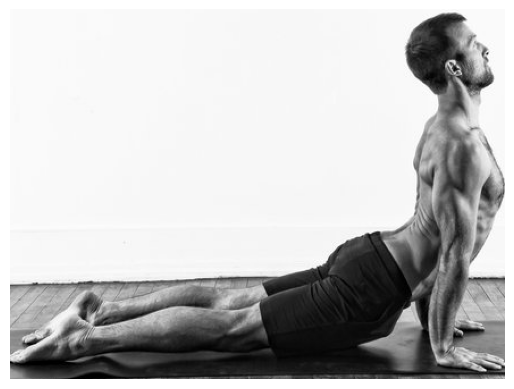

Displaying images for class: Ustrasana


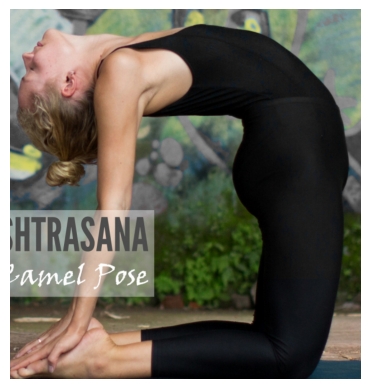

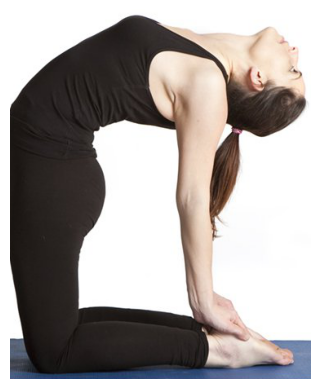

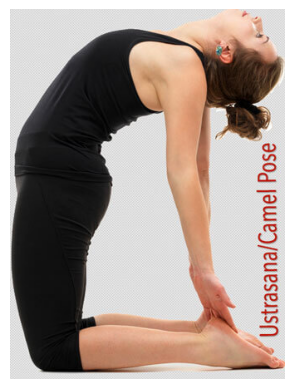

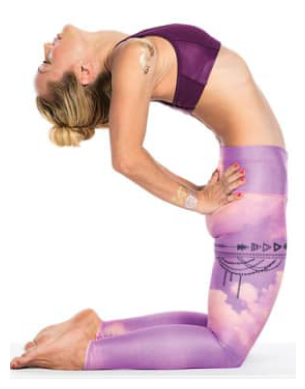

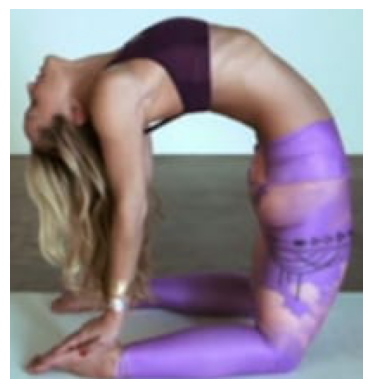

Displaying images for class: Utkatasana


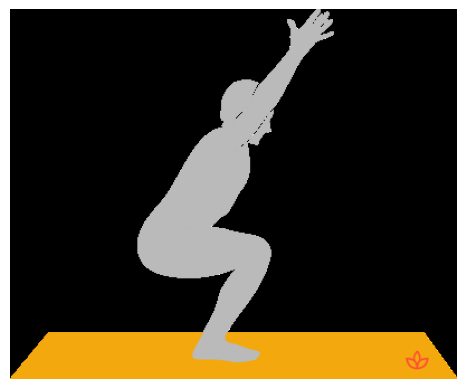

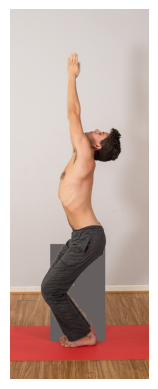

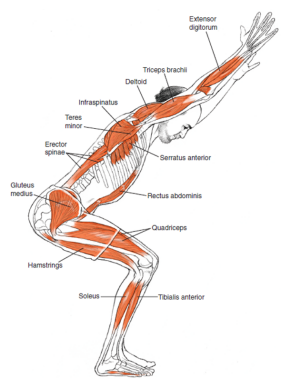

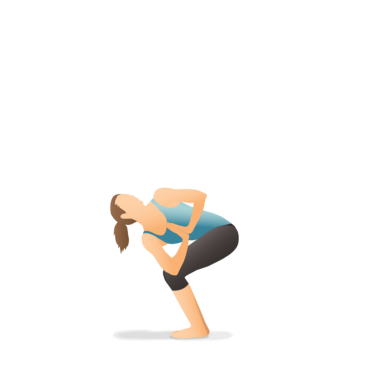

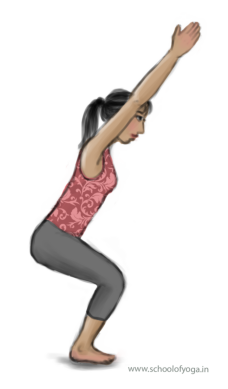

Displaying images for class: Uttanasana


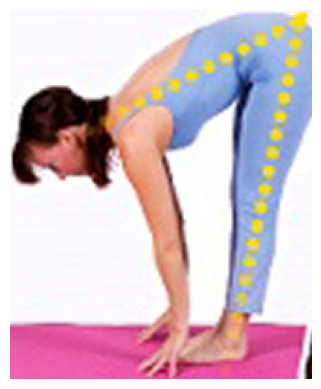

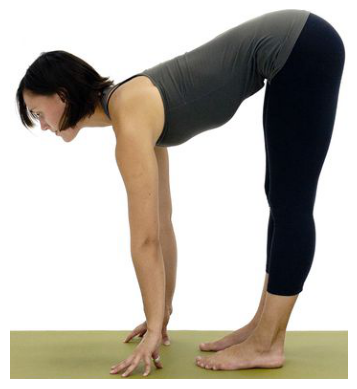

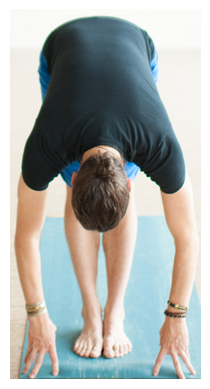

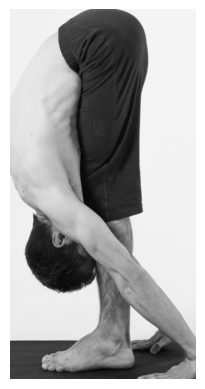

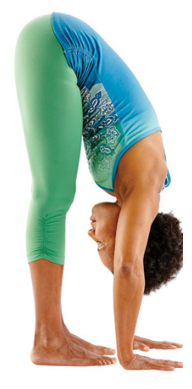

Displaying images for class: Utthita Hasta Padangusthasana


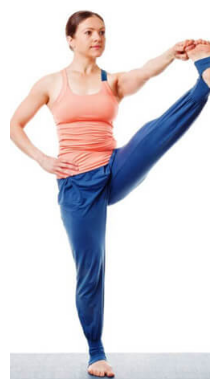

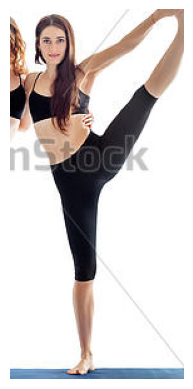

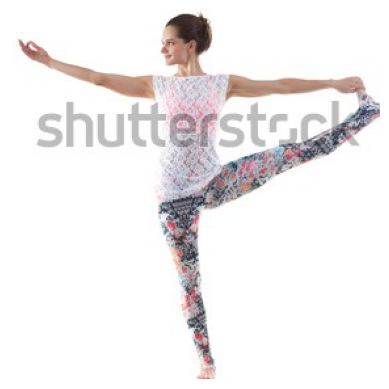

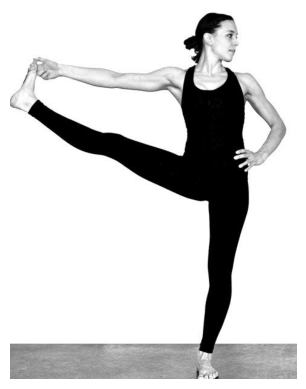

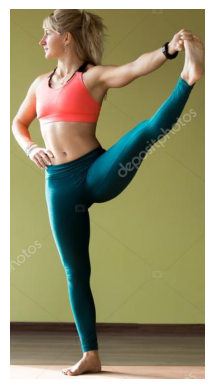

Displaying images for class: Utthita Parsvakonasana


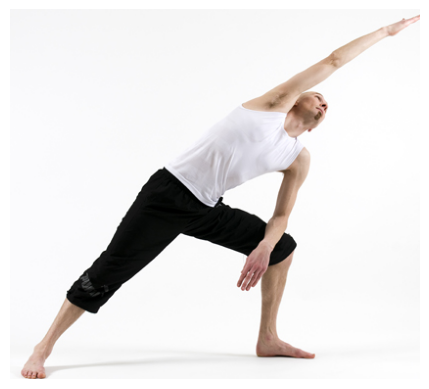

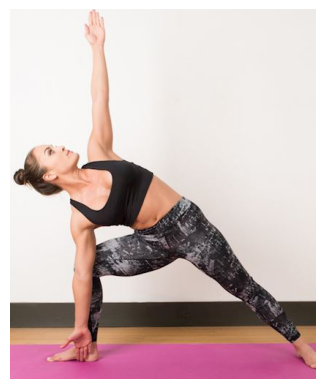

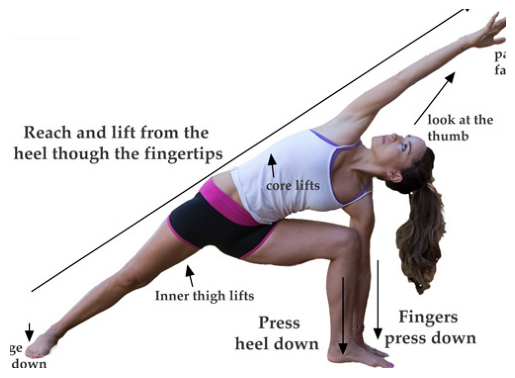

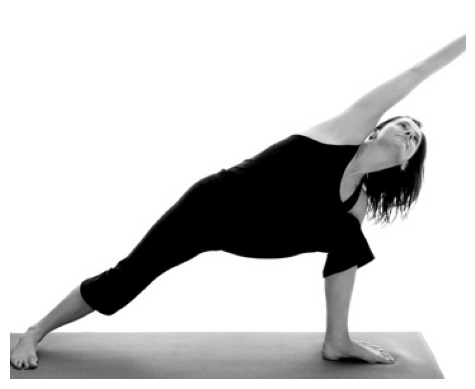

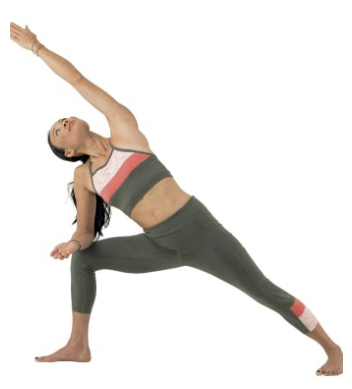

Displaying images for class: Vasisthasana


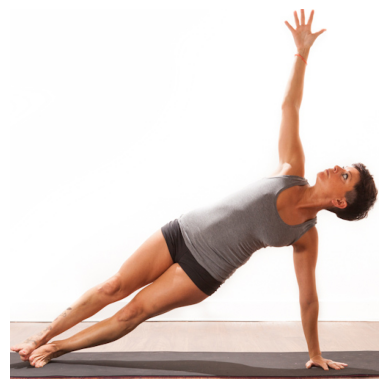

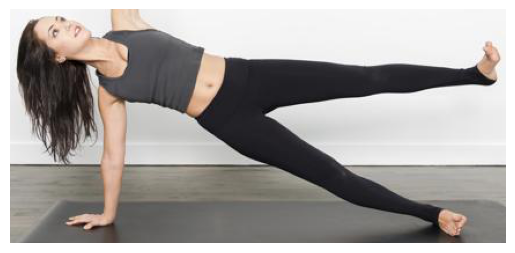

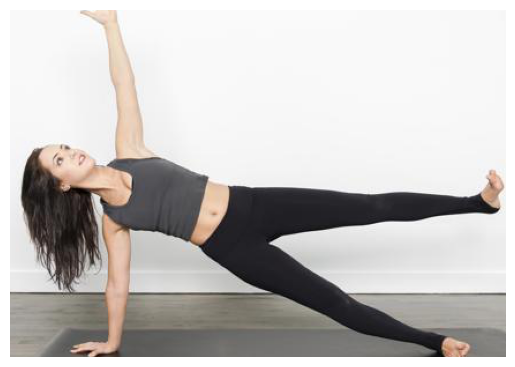

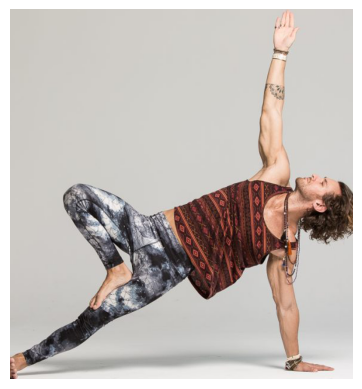

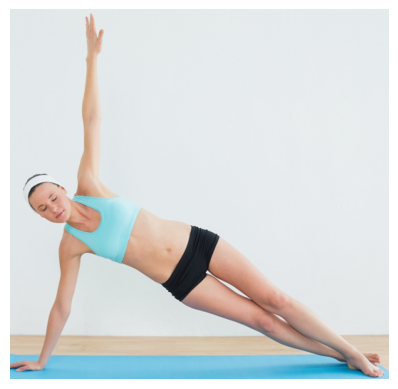

Displaying images for class: Virabhadrasana One


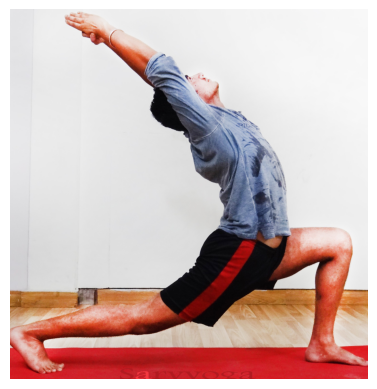

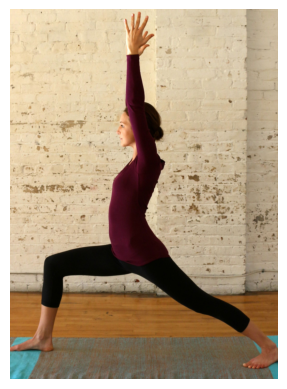

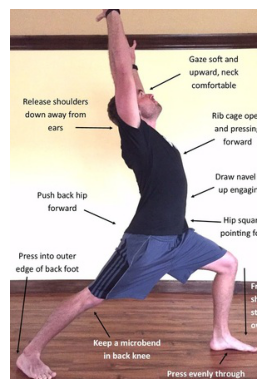

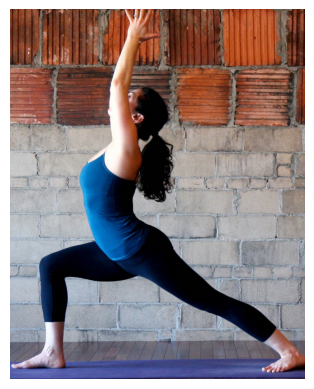

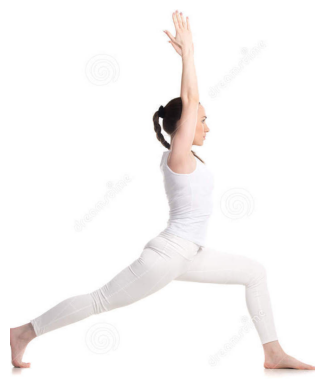

Displaying images for class: Virabhadrasana Three


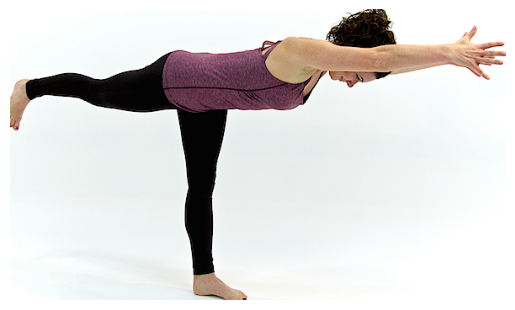

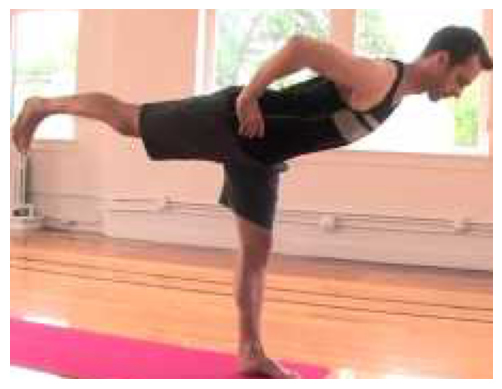

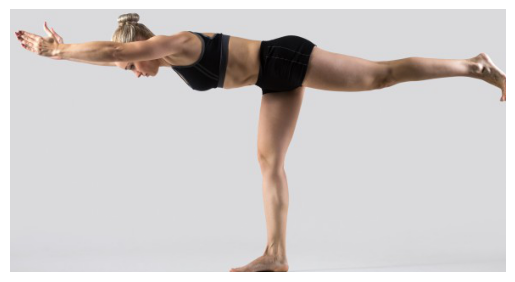

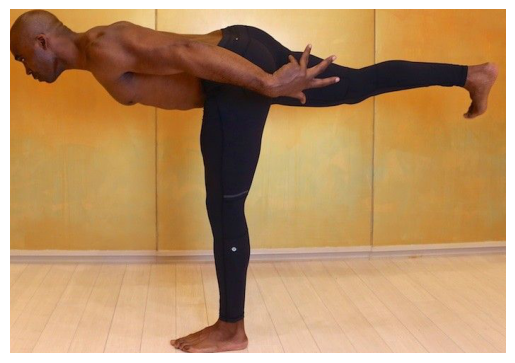

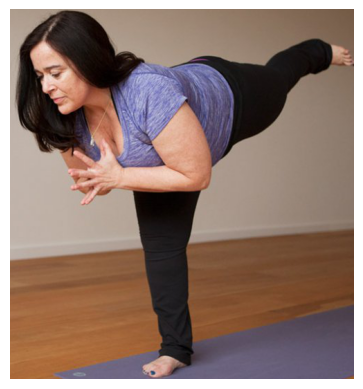

Displaying images for class: Virabhadrasana Two


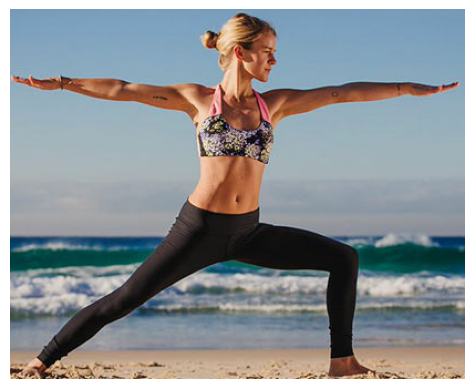

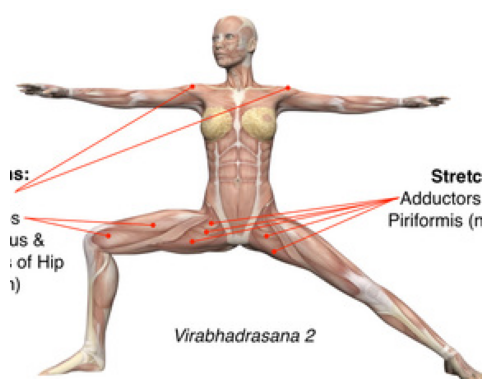

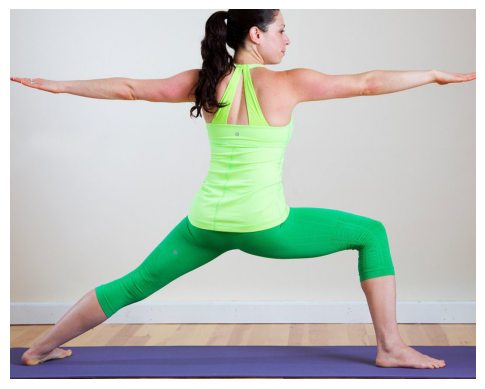

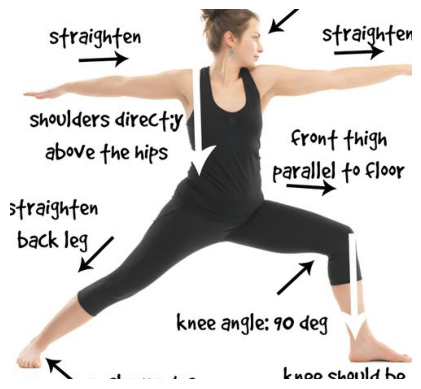

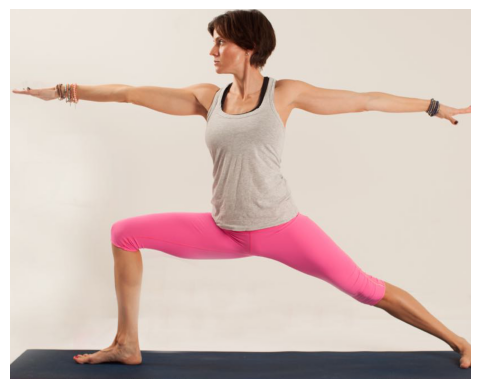

Displaying images for class: Vrksasana


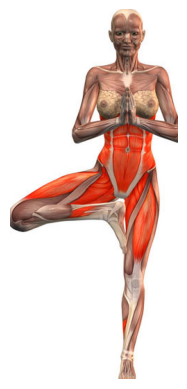

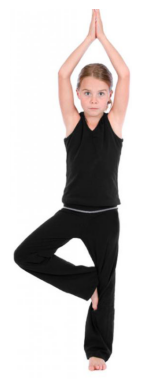

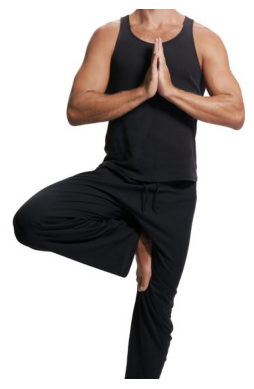

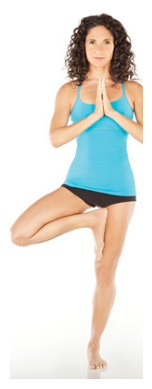

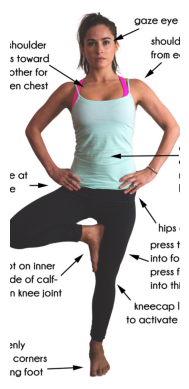

In [8]:
# I have displayed some sample images from each class
def display_sample_images(path, classes, num_samples=5):
    for cls in classes:
        class_path = os.path.join(path, cls)
        images = os.listdir(class_path)[:num_samples]
        print(f"Displaying images for class: {cls}")
        for img_name in images:
            img_path = os.path.join(class_path, img_name)
            img = cv2.imread(img_path)
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            plt.imshow(img)
            plt.axis('off')
            plt.show()

display_sample_images(dataset_path, class_folders)

In [9]:
# Image Preprocessing function
IMG_SIZE = 128 
def preprocess_images(path, classes):
    images, labels = [], []
    for idx, cls in enumerate(classes):
        class_path = os.path.join(path, cls)
        if not os.path.isdir(class_path):
            continue
        for img_name in os.listdir(class_path):
            img_path = os.path.join(class_path, img_name)
            img = cv2.imread(img_path)
            if img is None:
                print(f"Warning: Unable to read {img_path}. Skipping...")
                continue
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))  # Resize images to IMG_SIZE
            images.append(img)
            labels.append(idx)  # Append the label (yogasana class)
    return np.array(images), np.array(labels)

images, labels = preprocess_images(dataset_path, class_folders)

In [10]:
# Normalize the given images
images = images / 255.0

#Apply One hot encode labels
labels = to_categorical(labels, num_classes=len(class_folders))

print(f"Images shape: {images.shape}, Labels shape: {labels.shape}")

Images shape: (2756, 128, 128, 3), Labels shape: (2756, 47)


In [11]:
#Split the data into training and validation sets wheir 80% is for training and 20% is for validation
X_train, X_val, y_train, y_val = train_test_split(images, labels, test_size=0.2, random_state=42)
print(f"Training data: {X_train.shape}, Validation data: {X_val.shape}")

Training data: (2204, 128, 128, 3), Validation data: (552, 128, 128, 3)


In [26]:
# define the model , pass all the paramas for the tensorflow
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(IMG_SIZE, IMG_SIZE, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),  # Added more convolution layers
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(256, activation='relu'),  # Increased number of neurons
    Dropout(0.5),
    Dense(len(class_folders), activation='softmax')  # Output layer
])
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ conv2d_2 (Conv2D)                    │ (None, 126, 126, 32)        │             896 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 63, 63, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 61, 61, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 30, 30, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 28, 28, 128)         │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 14, 14, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 25088)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 256)                 │       6,422,784 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 256)                 │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_3 (Dense)                      │ (None, 47)                  │          12,079 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 6,528,111 (24.90 MB)

 Trainable params: 6,528,111 (24.90 MB)

 Non-trainable params: 0 (0.00 B)

In [13]:
#Use ImageDataGenerator for data augmentation and batching
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)
# Now fit the generator on the training data
datagen.fit(X_train)

In [27]:
from tensorflow.keras.callbacks import EarlyStopping

#I have done early stopping to prevent overfitting
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [28]:
# Train the model with epochs and early stopping,greater epochs enhances traing the model
history = model.fit(
    datagen.flow(X_train, y_train, batch_size=16),
    validation_data=(X_val, y_val),
    epochs=20,  
    #I have added early stopping to avoid overfitting
    callbacks=[early_stopping]
)

Epoch 1/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 44s 297ms/step - accuracy: 0.0274 - loss: 3.9536 - val_accuracy: 0.0399 - val_loss: 3.6852
Epoch 2/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 40s 289ms/step - accuracy: 0.0617 - loss: 3.7267 - val_accuracy: 0.0906 - val_loss: 3.5376
Epoch 3/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 39s 282ms/step - accuracy: 0.0747 - loss: 3.6168 - val_accuracy: 0.1685 - val_loss: 3.3078
Epoch 4/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 39s 281ms/step - accuracy: 0.0972 - loss: 3.5363 - val_accuracy: 0.1848 - val_loss: 3.1902
Epoch 5/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 38s 278ms/step - accuracy: 0.1072 - loss: 3.4444 - val_accuracy: 0.2101 - val_loss: 2.9961
Epoch 6/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1164 - loss: 3.3441 - val_accuracy: 0.2736 - val_loss: 2.8458
Epoch 7/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 38s 274ms/step - accuracy: 0.1404 - loss: 3.2669 - val_accuracy: 0.3043 - val_loss: 2.7425
Epoch 8/20
138/138 ━━━━━━━━━━━━━━━━━━━━ 39s 279ms/step - accuracy: 0.1821 - loss: 3

In [29]:
#Evaluate the model
val_loss, val_acc = model.evaluate(X_val, y_val)
print(f"Validation Loss: {val_loss}, Validation Accuracy: {val_acc}")

18/18 ━━━━━━━━━━━━━━━━━━━━ 2s 96ms/step - accuracy: 0.5290 - loss: 1.8008
Validation Loss: 1.7348864078521729, Validation Accuracy: 0.5380434989929199


In [30]:
#Save the trained model
model.save('yoga_pose_model.h5')

In [31]:
#Function to predict a pose for every new images provided
def predict_pose(image_path, model):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (IMG_SIZE, IMG_SIZE))
    #Normalize and add batch dimension
    img = np.expand_dims(img / 255.0, axis=0)  
    prediction = model.predict(img)
    #Get the predicted class index
    class_idx = np.argmax(prediction) 
    return class_folders[class_idx]  

In [32]:
#Path of the file which contain the images
sample_image = r'C:\Users\Atharva Vengurlekar\Downloads\Yoga_Pose_data\Adho Mukha Svanasana\File1.png'
predicted_pose = predict_pose(sample_image, model)
if predicted_pose:
    print(f"Predicted Pose: {predicted_pose}")
else:
    print("Failed to predict pose.")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 151ms/step
Predicted Pose: Padmasana


In [33]:
sample_image = r'C:\Users\Atharva Vengurlekar\Downloads\Yoga_Pose_data\Halasana\file4.png'
predicted_pose = predict_pose(sample_image, model)
if predicted_pose:
    print(f"Predicted Pose: {predicted_pose}")
else:
    print("Failed to predict pose.")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
Predicted Pose: Halasana


In [38]:
sample_image =r'C:\Users\Atharva Vengurlekar\Downloads\Yoga_Pose_data\Trikonasana\file1.jpeg'
print(f"Predicted Pose: {predict_pose(sample_image, model)}")

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step
Predicted Pose: Trikonasana
